In [11]:
import cellxgene_census as cxg
from cellxgene_census.experimental import get_embedding
import numpy as np
import pinecone
import os
import os
from pinecone import Pinecone, ServerlessSpec
import scanpy as sc

In [13]:
m_adata = sc.read_h5ad("combined_messmer_uce_adata.h5ad")

In [22]:
embedding_uri = \
    "s3://cellxgene-contrib-public/contrib/cell-census/soma/2023-12-15/CxG-contrib-2"
census = cxg.open_soma(census_version="2023-12-15")

In [27]:
adata = cxg.get_anndata(
    census,
    organism = "homo_sapiens",
    measurement_name = "RNA",
    obs_value_filter = "tissue_general == 'musculature'",
)

In [28]:
adata

AnnData object with n_obs × n_vars = 189452 × 60664
    obs: 'soma_joinid', 'dataset_id', 'assay', 'assay_ontology_term_id', 'cell_type', 'cell_type_ontology_term_id', 'development_stage', 'development_stage_ontology_term_id', 'disease', 'disease_ontology_term_id', 'donor_id', 'is_primary_data', 'self_reported_ethnicity', 'self_reported_ethnicity_ontology_term_id', 'sex', 'sex_ontology_term_id', 'suspension_type', 'tissue', 'tissue_ontology_term_id', 'tissue_general', 'tissue_general_ontology_term_id', 'raw_sum', 'nnz', 'raw_mean_nnz', 'raw_variance_nnz', 'n_measured_vars'
    var: 'soma_joinid', 'feature_id', 'feature_name', 'feature_length', 'nnz', 'n_measured_obs'

In [29]:
embeddings = get_embedding("2023-12-15", embedding_uri, adata.obs["soma_joinid"].to_numpy())
adata.obsm["emb"] = embeddings

In [30]:
lst = []
for i in adata.obs.cell_type:
    if i not in lst:
        lst.append(i)

In [31]:
lst

['endothelial cell of vascular tree',
 'capillary endothelial cell',
 'endothelial cell of lymphatic vessel',
 'mesenchymal stem cell',
 'endothelial cell of artery',
 'pericyte',
 'CD4-positive, alpha-beta T cell',
 'skeletal muscle satellite stem cell',
 'macrophage',
 'CD8-positive, alpha-beta T cell',
 'T cell',
 'smooth muscle cell',
 'tendon cell',
 'fast muscle cell',
 'slow muscle cell',
 'mast cell',
 'erythrocyte',
 'mesothelial cell',
 'mature NK T cell',
 'skeletal muscle fiber',
 'skeletal muscle fibroblast',
 'contractile cell',
 'professional antigen presenting cell',
 'dendritic cell',
 'subcutaneous fat cell',
 'Schwann cell',
 'skeletal muscle satellite cell',
 'neutrophil',
 'classical monocyte',
 'conventional dendritic cell',
 'alveolar macrophage',
 'non-classical monocyte',
 'animal cell',
 'naive thymus-derived CD8-positive, alpha-beta T cell',
 'effector memory CD8-positive, alpha-beta T cell, terminally differentiated',
 'CD16-positive, CD56-dim natural killer

In [32]:
cell_dict = {}
for cell_type in lst:
    indices = adata.obs[adata.obs.cell_type == cell_type].index[:5]
    for idx in indices:
        cell_dict[idx] = cell_type

In [33]:
cell_dict

{'0': 'endothelial cell of vascular tree',
 '1': 'endothelial cell of vascular tree',
 '6': 'endothelial cell of vascular tree',
 '9': 'endothelial cell of vascular tree',
 '11': 'endothelial cell of vascular tree',
 '2': 'capillary endothelial cell',
 '5': 'capillary endothelial cell',
 '7': 'capillary endothelial cell',
 '10': 'capillary endothelial cell',
 '14': 'capillary endothelial cell',
 '3': 'endothelial cell of lymphatic vessel',
 '4': 'endothelial cell of lymphatic vessel',
 '8': 'endothelial cell of lymphatic vessel',
 '12': 'endothelial cell of lymphatic vessel',
 '15': 'endothelial cell of lymphatic vessel',
 '26': 'mesenchymal stem cell',
 '68': 'mesenchymal stem cell',
 '170': 'mesenchymal stem cell',
 '202': 'mesenchymal stem cell',
 '261': 'mesenchymal stem cell',
 '39': 'endothelial cell of artery',
 '230': 'endothelial cell of artery',
 '1299': 'endothelial cell of artery',
 '2344': 'endothelial cell of artery',
 '2359': 'endothelial cell of artery',
 '49': 'pericyt

In [42]:
def insert_cells_embeddings_into_pinecone(embeddings, cell_dict):
    # Ensure embeddings is a numpy array and has the correct shape
    if not isinstance(embeddings, np.ndarray) or embeddings.ndim != 2:
        raise ValueError("embeddings must be a 2D numpy array")
    
    # Set up Pinecone
    pinecone_api_key = "4bad049e-b1eb-45da-9a7d-e4fa1f144fc6"
    pc = Pinecone(api_key=pinecone_api_key)

    # Specify your Pinecone index name
    index_name = 'uceindex'
    
    # Ensure your Pinecone index is created beforehand or create it if not exists
    if index_name not in pc.list_indexes().names():
        pc.create_index(
            name=index_name,
            dimension=embeddings.shape[1],  # Assuming all embeddings have the same dimension
            metric='cosine',
            spec=ServerlessSpec(
                cloud='gcp-starter',  # Adjust cloud provider and region as per your setup
                region='us-central1'
            )
        )
    
    # Connect to your Pinecone index
    index = pc.Index(name=index_name)
    
    # Prepare the data for insertion
    vectors = [(str(idx), embeddings[int(idx)]) for idx in cell_dict.keys()]
    
    # Insert the embeddings into Pinecone
    index.upsert(vectors=vectors)
    
    print("Cell embeddings inserted into Pinecone successfully.")

In [43]:
insert_cells_embeddings_into_pinecone(embeddings, cell_dict)

Cell embeddings inserted into Pinecone successfully.


In [44]:
def find_similar_embeddings(embedding):
    # Set up Pinecone
    pinecone_api_key = "4bad049e-b1eb-45da-9a7d-e4fa1f144fc6"
    pc = Pinecone(api_key=pinecone_api_key)

    # Specify your Pinecone index name
    index_name = 'uceindex'
    
    # Ensure the index exists
    if index_name not in pc.list_indexes().names():
        raise ValueError(f"Index {index_name} does not exist. Please create the index before querying.")
    
    # Connect to your Pinecone index
    index = pc.Index(name=index_name)
    
    # Query the index for the 5 most similar embeddings
    query_result = index.query(vector=[embedding.tolist()], top_k=5)
    
    # Extract the IDs of the most similar embeddings
    similar_ids = [match["id"] for match in query_result["matches"]]
    
    return similar_ids

In [71]:
similar_cells = find_similar_embeddings(m_adata.obsm["X_uce"][13])
print(similar_cells)
for cell in similar_cells:
    print(cell_dict[cell])

['95', '267', '1974', '263', '272']
skeletal muscle satellite stem cell
skeletal muscle satellite stem cell
mesothelial cell
skeletal muscle satellite stem cell
skeletal muscle satellite stem cell


In [70]:
m_adata.obs[m_adata.obs["predicted.pheno"] == "FAPs"]

,Unique_barcode,orig.ident,nCount_RNA,nFeature_RNA,Cell_barcode,Category,Genotype,nSNPcovered,nUMIS_perSNP,PRB.DBL,PRB.SNG1,percent.mt,S.Score,G2M.Score,Phase,predicted.pheno,n_genes
2,AAACGAAAGATTCGCT.1_1,Injection1,1683,954,AAACGAAAGATTCGCT-1,SNG,4,20,29,133.000000,1.0,4.812834,0.009090,-0.057690,S,FAPs,3773
4,AAACGAAAGGGATGTC.1_1,Injection1,3845,1603,AAACGAAAGGGATGTC-1,SNG,5,15,34,0.082900,1.0,2.054616,-0.032146,-0.050452,G1,FAPs,3326
6,AAACGAATCGACCATA.1_1,Injection1,4002,1540,AAACGAATCGACCATA-1,SNG,4,13,39,0.051600,999.0,3.998001,-0.014514,-0.065396,G1,FAPs,3326
8,AAACGCTCAGTCTTCC.1_1,Injection1,7544,2751,AAACGCTCAGTCTTCC-1,SNG,6,63,173,0.000553,1.0,2.372747,0.059007,-0.023475,S,FAPs,3444
13,AAACGCTTCAGCCTCT.1_1,Injection1,4838,1925,AAACGCTTCAGCCTCT-1,SNG,4,32,73,0.000986,1.0,2.521703,-0.027642,-0.036486,G1,FAPs,3353
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36124,TTTGGAGTCTGTAAGC.1_5,Injection5,43922,5781,TTTGGAGTCTGTAAGC-1,SNG,6,55,122,0.002910,1.0,1.525431,0.442910,0.492262,G2M,FAPs,4856
36125,TTTGGTTTCGTTCTCG.1_5,Injection5,9623,2715,TTTGGTTTCGTTCTCG-1,SNG,6,17,25,222.000000,999.0,1.776993,0.011761,-0.179093,S,FAPs,2891
36126,TTTGTTGAGCGAATGC.1_5,Injection5,22437,4109,TTTGTTGAGCGAATGC-1,SNG,4,28,63,0.005330,1.0,1.377189,0.234535,-0.113138,S,FAPs,4109
36127,TTTGTTGCATGAATAG.1_5,Injection5,18687,4222,TTTGTTGCATGAATAG-1,SNG,1,35,62,0.003930,1.0,2.247552,0.004360,0.246653,G2M,FAPs,4222


In [56]:
new = m_adata.obs["predicted.pheno"].

In [58]:
unique_phenos_str = "\n".join(new)
print(unique_phenos_str)

Neutrophils
B/T/NK cells
FAPs
VECs
SMMCs
SCs
Monocytes / M?
LECs
Myocytes
Tenocytes
Glial cells


In [79]:
adata.obs["cell_type"]

0            endothelial cell of vascular tree
1            endothelial cell of vascular tree
2                   capillary endothelial cell
3         endothelial cell of lymphatic vessel
4         endothelial cell of lymphatic vessel
                          ...                 
189447                        endothelial cell
189448                            stromal cell
189449                            stromal cell
189450                            stromal cell
189451                  erythroid lineage cell
Name: cell_type, Length: 189452, dtype: object

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

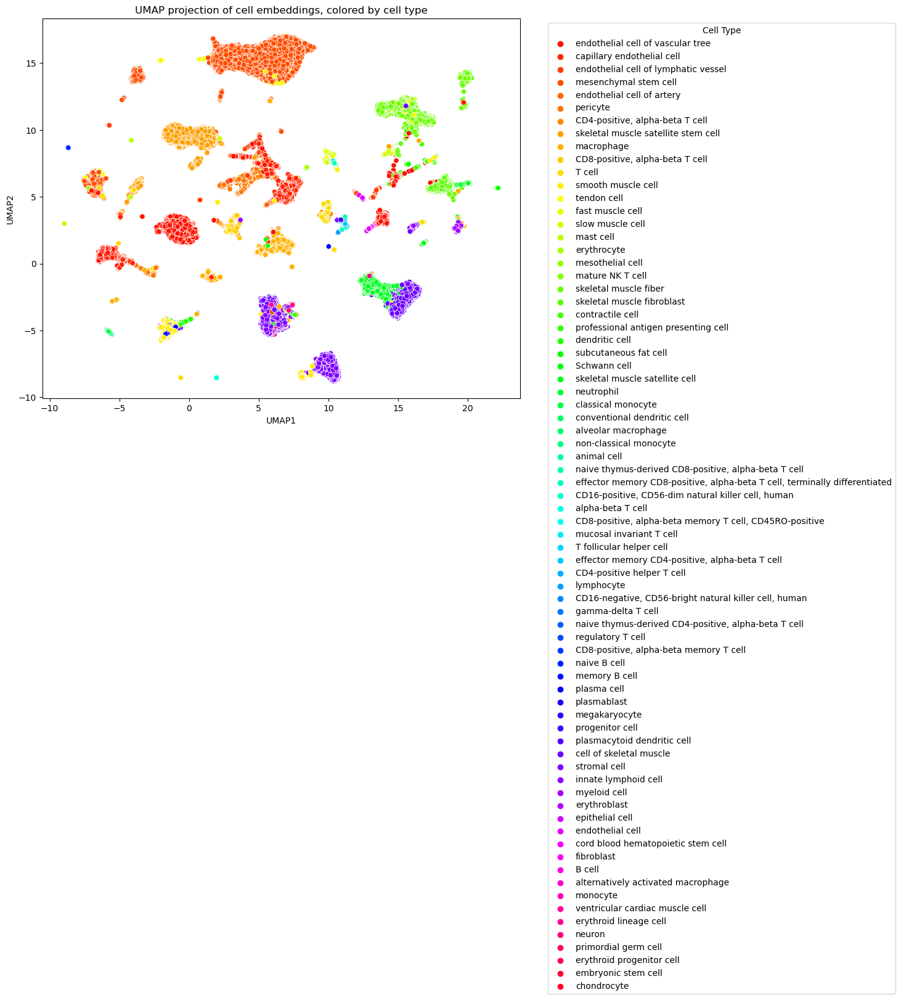

In [81]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming `adata` is your Anndata object with embeddings in adata.obsm["emb"] 
# and cell types in adata.obs["cell_type"]

# Compute UMAP projections
reducer = umap.UMAP()
umap_embeddings = reducer.fit_transform(adata.obsm["emb"])

# Create a DataFrame for easier plotting
df = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
df['cell_type'] = adata.obs["cell_type"].values

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="cell_type", palette=sns.color_palette("hsv", len(df['cell_type'].unique())), data=df)
plt.title('UMAP projection of cell embeddings, colored by cell type')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

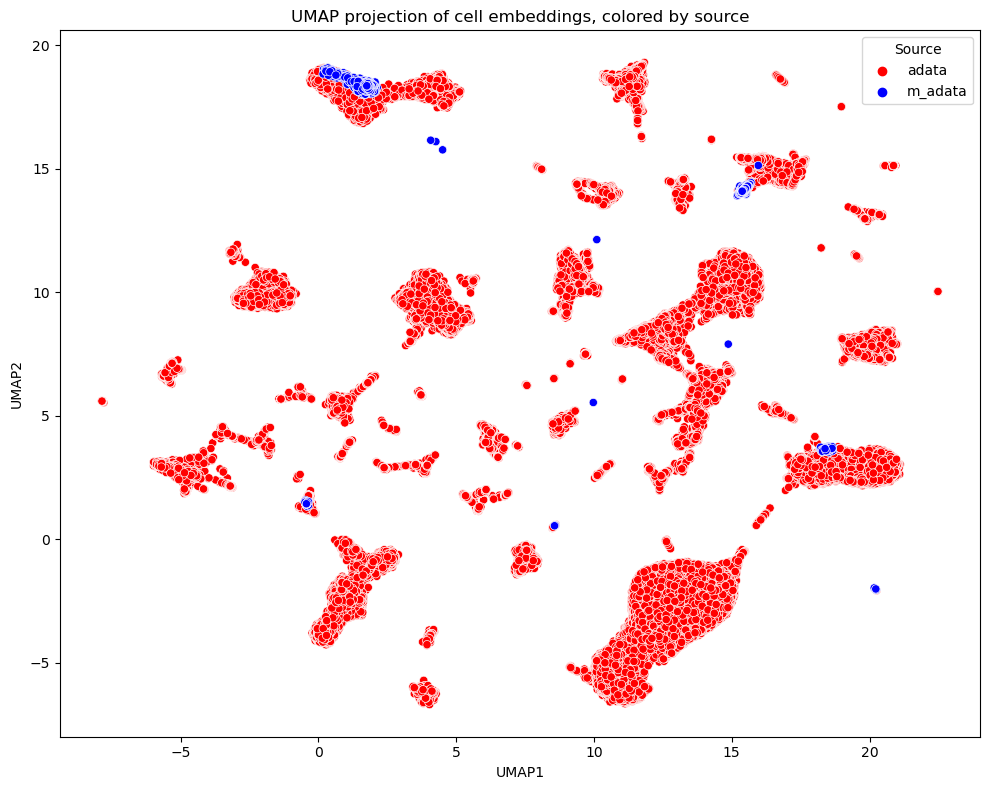

In [82]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming `adata` is your Anndata object with original embeddings 
# and `m_adata` is another Anndata object with embeddings in m_adata.obsm["X_uce"]

# Compute UMAP projections for both datasets
reducer = umap.UMAP()
umap_embeddings_adata = reducer.fit_transform(adata.obsm["emb"])
umap_embeddings_m_adata = reducer.transform(m_adata.obsm["X_uce"])  # Using the same reducer to ensure consistent UMAP space

# Create DataFrames for easier plotting
df_adata = pd.DataFrame(umap_embeddings_adata, columns=['UMAP1', 'UMAP2'])
df_adata['source'] = 'adata'

df_m_adata = pd.DataFrame(umap_embeddings_m_adata, columns=['UMAP1', 'UMAP2'])
df_m_adata['source'] = 'm_adata'

# Combine both DataFrames
df_combined = pd.concat([df_adata, df_m_adata], ignore_index=True)

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="source", palette=['red', 'blue'], data=df_combined)
plt.title('UMAP projection of cell embeddings, colored by source')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Source')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

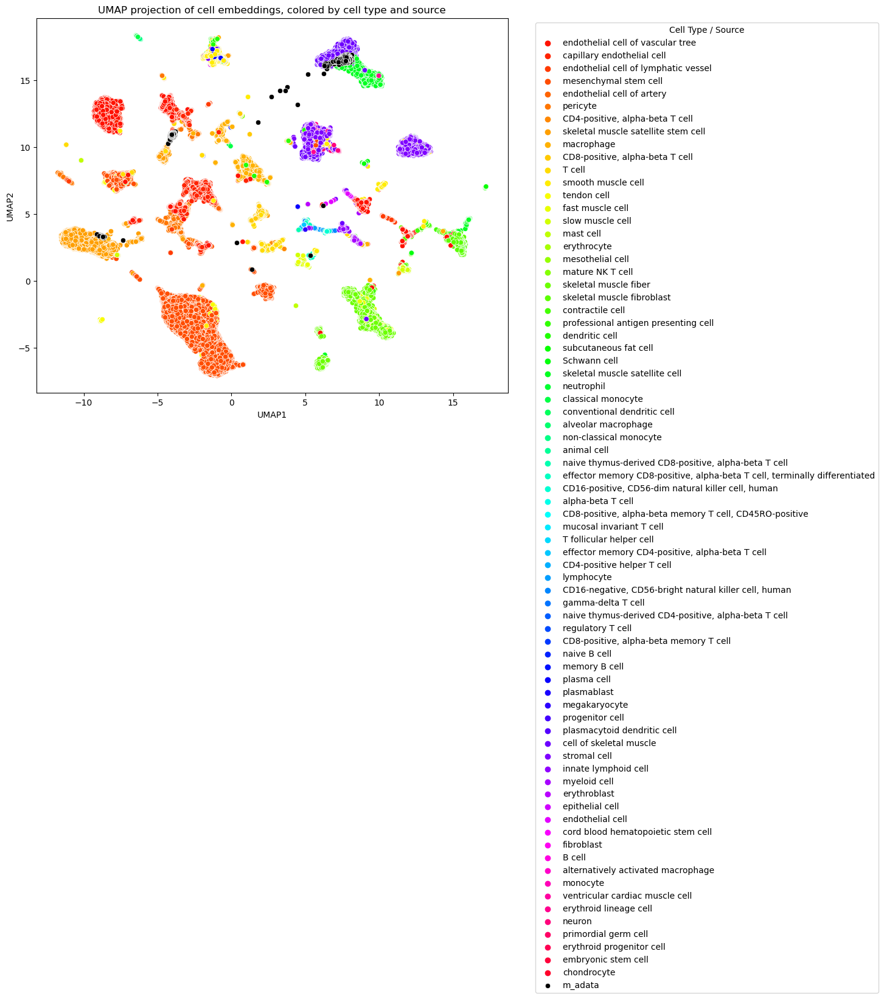

In [83]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming `adata` is your Anndata object with original embeddings and cell types
# and `m_adata` is another Anndata object with embeddings in m_adata.obsm["X_uce"]

# Compute UMAP projections for both datasets using a single UMAP model
reducer = umap.UMAP()
umap_embeddings_adata = reducer.fit_transform(adata.obsm["emb"])
umap_embeddings_m_adata = reducer.transform(m_adata.obsm["X_uce"])

# Create a DataFrame for adata for easier plotting
df_adata = pd.DataFrame(umap_embeddings_adata, columns=['UMAP1', 'UMAP2'])
df_adata['Type'] = adata.obs["cell_type"].values
df_adata['Source'] = 'adata'

# Create a DataFrame for m_adata
df_m_adata = pd.DataFrame(umap_embeddings_m_adata, columns=['UMAP1', 'UMAP2'])
df_m_adata['Type'] = 'm_adata'  # Marking all m_adata embeddings distinctly
df_m_adata['Source'] = 'm_adata'

# Combine both DataFrames
df_combined = pd.concat([df_adata, df_m_adata], ignore_index=True)

# Plotting
plt.figure(figsize=(10, 8))
# Plot adata embeddings colored by cell type
sns.scatterplot(data=df_combined[df_combined['Source'] == 'adata'], x='UMAP1', y='UMAP2', hue='Type', palette=sns.color_palette("hsv", len(df_adata['Type'].unique())))
# Plot m_adata embeddings in black
sns.scatterplot(data=df_combined[df_combined['Source'] == 'm_adata'], x='UMAP1', y='UMAP2', color='black', label='m_adata')

plt.title('UMAP projection of cell embeddings, colored by cell type and source')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type / Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

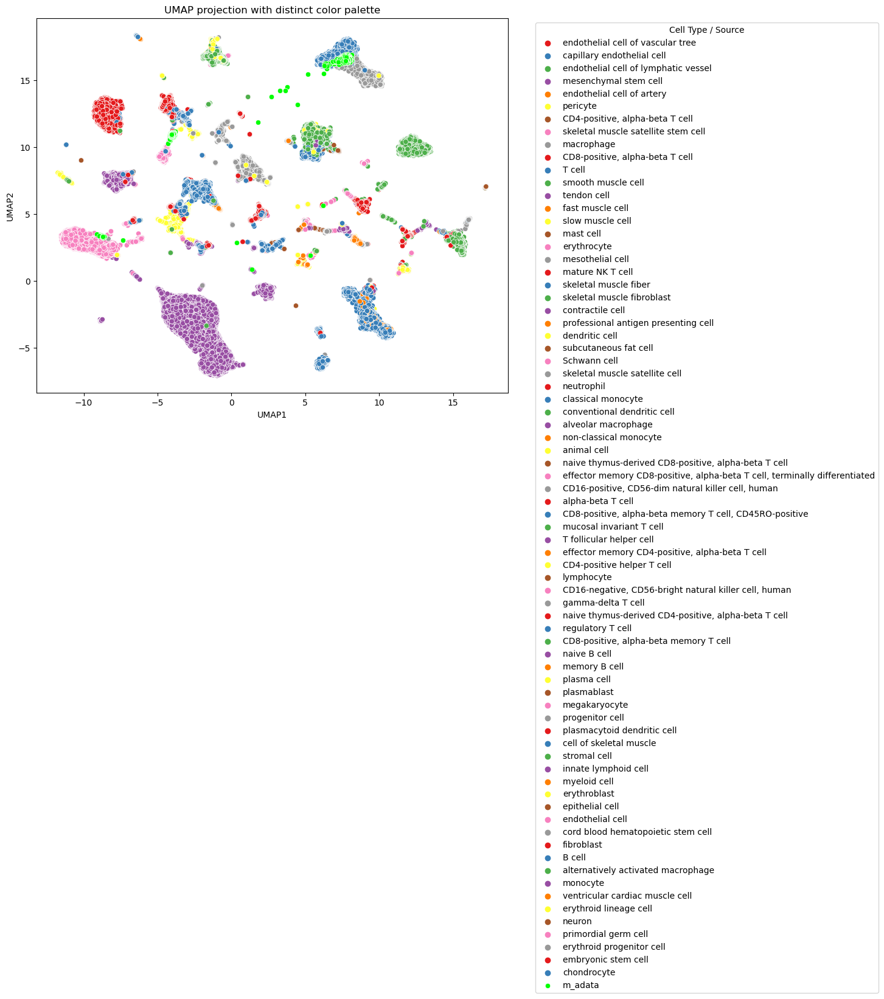

In [85]:
# Plotting with a distinct color palette
plt.figure(figsize=(10, 8))
# Use a Matplotlib palette with distinct colors for adata embeddings. Example: 'Set1'
# Ensure the palette has enough colors for all cell types, or they will repeat.
palette = sns.color_palette('Set1', n_colors=len(df_adata['Type'].unique()))
sns.scatterplot(data=df_combined[df_combined['Source'] == 'adata'], x='UMAP1', y='UMAP2', hue='Type', palette=palette)
# For m_adata embeddings, continue using a distinct color, like 'lime' or another clearly different color
sns.scatterplot(data=df_combined[df_combined['Source'] == 'm_adata'], x='UMAP1', y='UMAP2', color='lime', label='m_adata')

plt.title('UMAP projection with distinct color palette')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type / Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

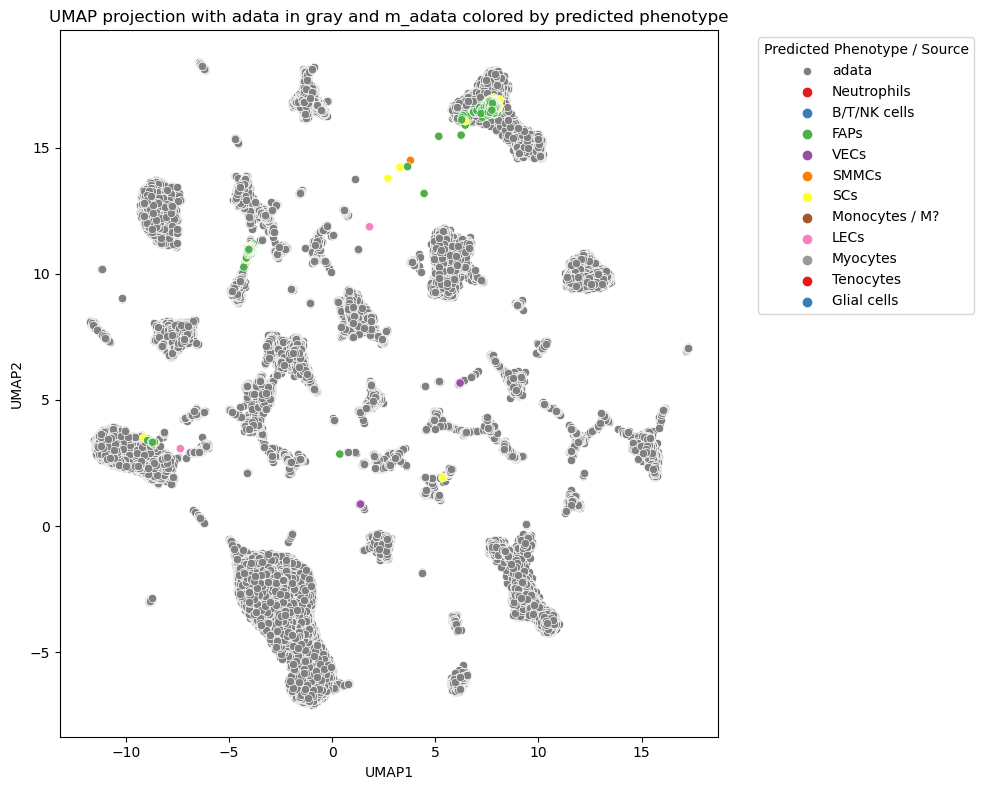

In [88]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming the initial setup is done and umap_embeddings_adata, umap_embeddings_m_adata are already computed

# Update the DataFrame for adata to have a single color
df_adata['Color'] = 'gray'  # All adata embeddings in gray

# Update the DataFrame for m_adata to include 'predicted.pheno'
df_m_adata['Type'] = m_adata.obs["predicted.pheno"].values
# Ensure distinct non-continuous colors for 'predicted.pheno'
# Use a distinct palette like 'Set1', adjusting for the number of unique predicted phenotypes
unique_phenos = df_m_adata['Type'].nunique()
palette = sns.color_palette('Set1', n_colors=unique_phenos)

# Combine both DataFrames
df_combined = pd.concat([df_adata, df_m_adata], ignore_index=True)

# Plotting
plt.figure(figsize=(10, 8))
# Plot adata embeddings in gray
sns.scatterplot(data=df_combined[df_combined['Source'] == 'adata'], x='UMAP1', y='UMAP2', color='gray', label='adata')
# Plot m_adata embeddings colored by 'predicted.pheno'
sns.scatterplot(data=df_combined[df_combined['Source'] == 'm_adata'], x='UMAP1', y='UMAP2', hue='Type', palette=palette)

plt.title('UMAP projection with adata in gray and m_adata colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype / Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


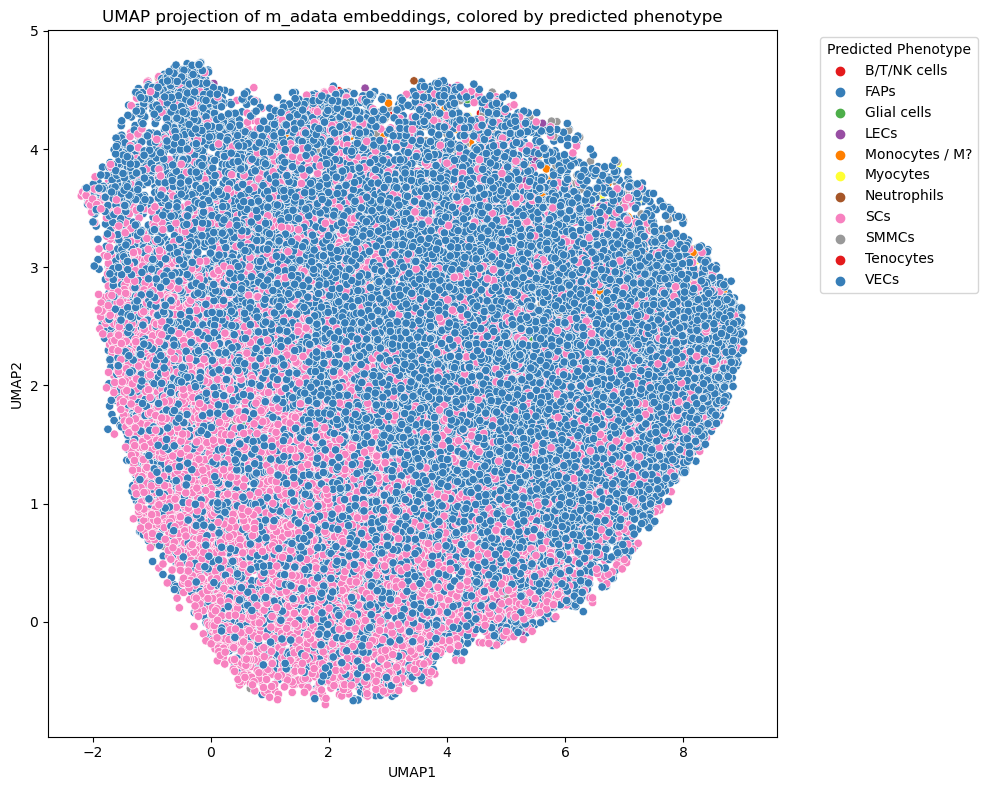

In [89]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming `m_adata` is your Anndata object with embeddings in m_adata.obsm["X_uce"] 
# and predicted phenotypes in m_adata.obs["predicted.pheno"]

# Compute UMAP projections for m_adata embeddings
reducer = umap.UMAP()
umap_embeddings_m_adata = reducer.fit_transform(m_adata.obsm["X_uce"])

# Create a DataFrame for m_adata for easier plotting
df_m_adata = pd.DataFrame(umap_embeddings_m_adata, columns=['UMAP1', 'UMAP2'])
df_m_adata['Predicted Phenotype'] = m_adata.obs["predicted.pheno"].values

# Ensure distinct non-continuous colors for 'Predicted Phenotype'
# Use a distinct palette like 'Set1', adjusting for the number of unique predicted phenotypes
palette = sns.color_palette('Set1', n_colors=df_m_adata['Predicted Phenotype'].nunique())

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(data=df_m_adata, x='UMAP1', y='UMAP2', hue='Predicted Phenotype', palette=palette)

plt.title('UMAP projection of m_adata embeddings, colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


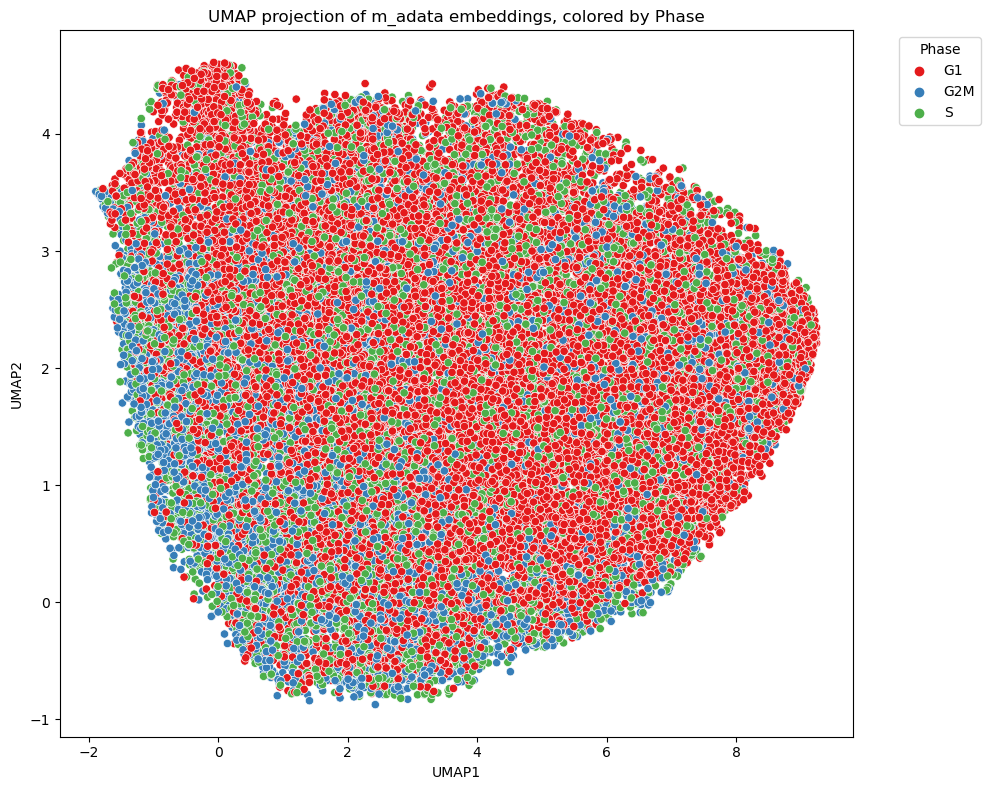

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


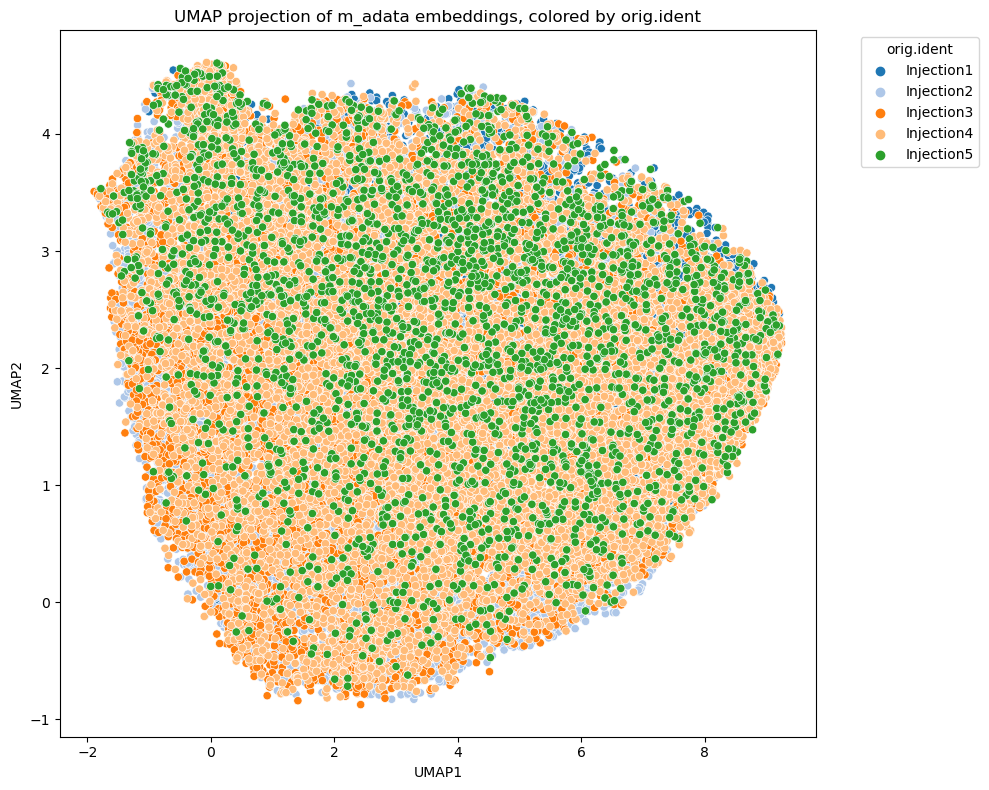

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

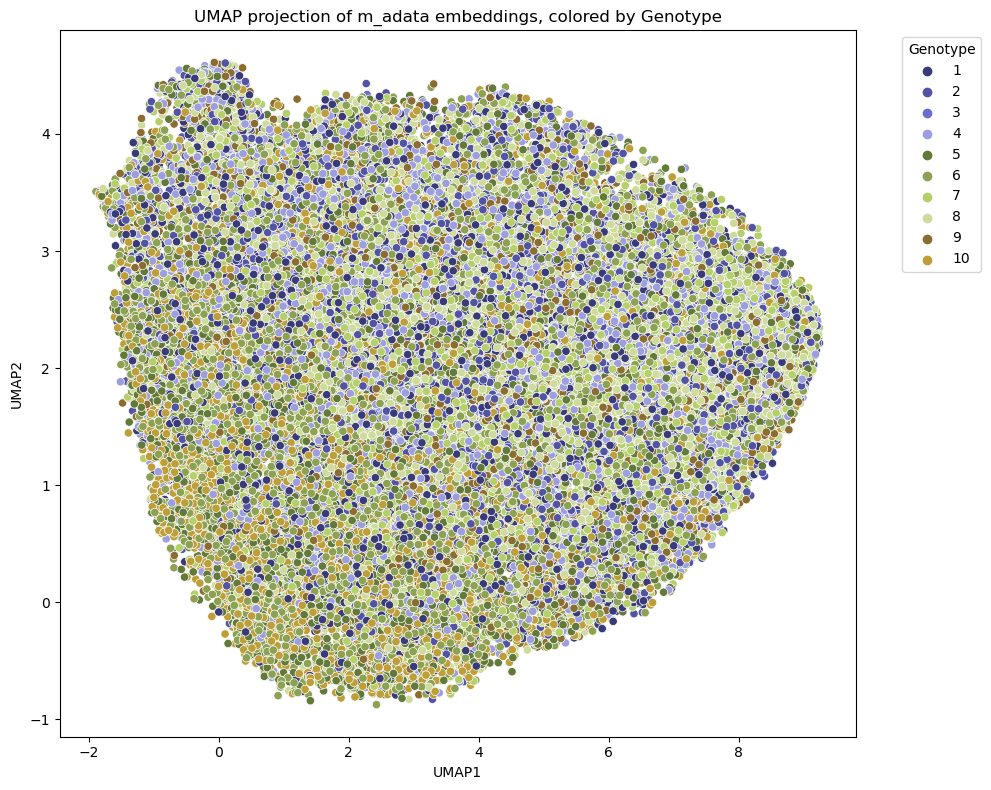

In [92]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming `m_adata` is already loaded with embeddings in m_adata.obsm["X_uce"]
# and it has the attributes "Phase", "orig.ident", and "Genotype" in m_adata.obs

# Compute UMAP projections once, as it will be the same for all plots
reducer = umap.UMAP()
umap_embeddings_m_adata = reducer.fit_transform(m_adata.obsm["X_uce"])

# Create a DataFrame for m_adata for easier plotting
df_m_adata = pd.DataFrame(umap_embeddings_m_adata, columns=['UMAP1', 'UMAP2'])
df_m_adata['Phase'] = m_adata.obs["Phase"].values
df_m_adata['orig.ident'] = m_adata.obs["orig.ident"].values
df_m_adata['Genotype'] = m_adata.obs["Genotype"].values

# Define a function to plot UMAP by given category
def plot_umap(data, category, palette='Set1'):
    plt.figure(figsize=(10, 8))
    unique_categories = data[category].nunique()
    sns.scatterplot(data=data, x='UMAP1', y='UMAP2', hue=category, palette=sns.color_palette(palette, n_colors=unique_categories))
    plt.title(f'UMAP projection of m_adata embeddings, colored by {category}')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.legend(title=category, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# Plot by Phase
plot_umap(df_m_adata, 'Phase')

# Plot by orig.ident
plot_umap(df_m_adata, 'orig.ident', palette='tab20')

# Plot by Genotype
plot_umap(df_m_adata, 'Genotype', palette='tab20b')


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


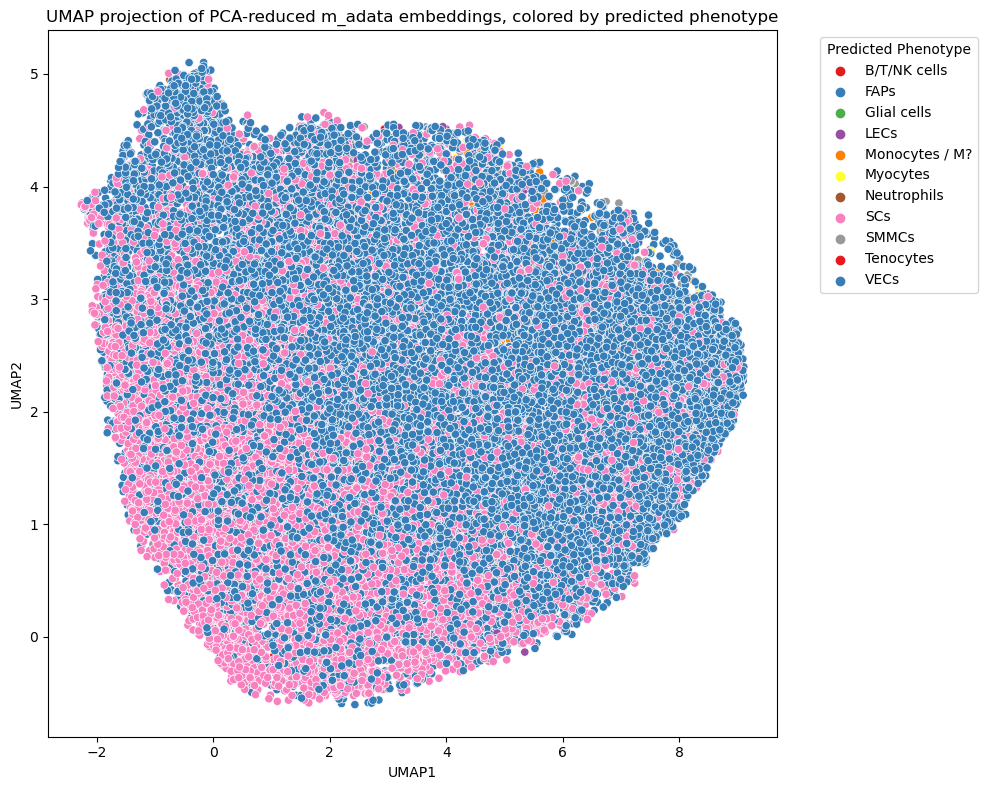

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
from sklearn.decomposition import PCA
import pandas as pd

# Assuming `m_adata` is your Anndata object with embeddings in m_adata.obsm["X_uce"]
# and predicted phenotypes in m_adata.obs["predicted.pheno"]

# Step 1: Apply PCA for dimensionality reduction
pca = PCA(n_components=50)  # Using 50 components as a common choice, adjust based on your data
pca_embeddings = pca.fit_transform(m_adata.obsm["X_uce"])

# Step 2: Compute UMAP projections on PCA-reduced data
reducer = umap.UMAP()
umap_embeddings = reducer.fit_transform(pca_embeddings)

# Step 3: Create a DataFrame for plotting
df = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
df['Predicted Phenotype'] = m_adata.obs["predicted.pheno"].values

# Ensure distinct non-continuous colors for 'Predicted Phenotype'
palette = sns.color_palette('Set1', n_colors=df['Predicted Phenotype'].nunique())

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(data=df, x='UMAP1', y='UMAP2', hue='Predicted Phenotype', palette=palette)

plt.title('UMAP projection of PCA-reduced m_adata embeddings, colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

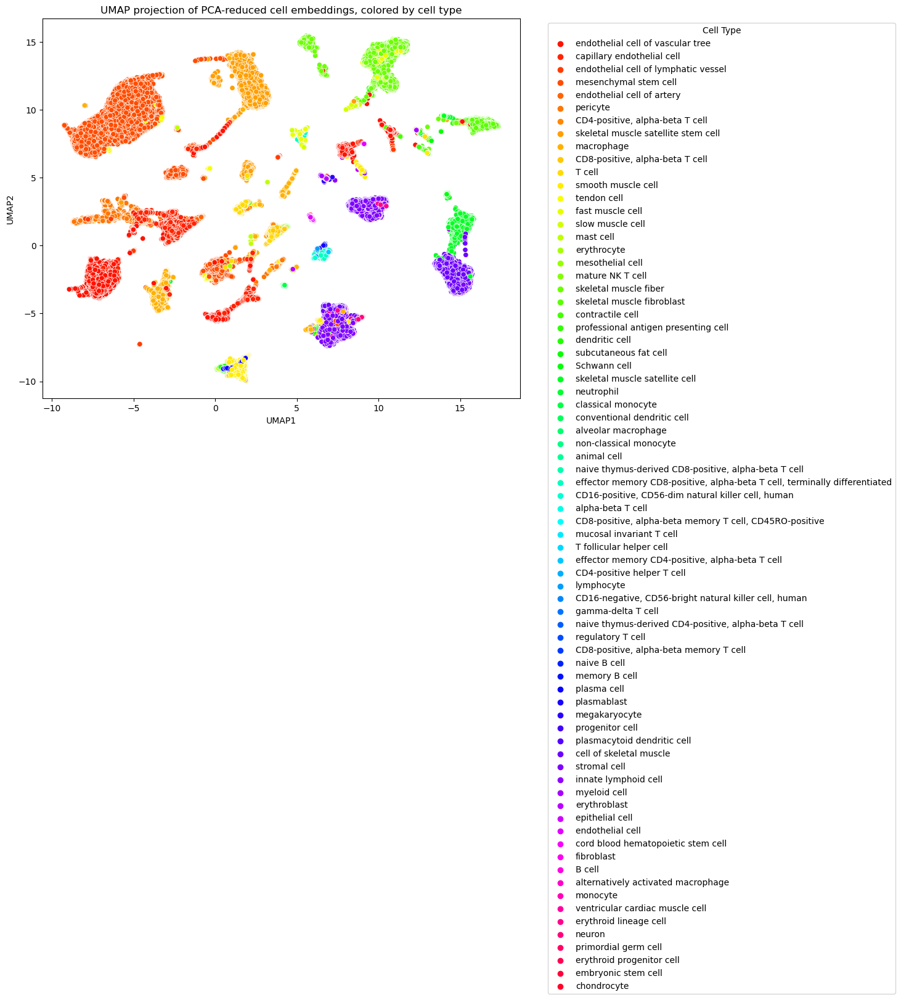

In [94]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import umap
import pandas as pd

# Assuming `adata` is your Anndata object with embeddings in adata.obsm["emb"] 
# and cell types in adata.obs["cell_type"]

# Step 1: Apply PCA for dimensionality reduction
pca = PCA(n_components=50)  # Choosing 50 components, but you can adjust this
pca_embeddings = pca.fit_transform(adata.obsm["emb"])

# Step 2: Compute UMAP projections on PCA-reduced data
reducer = umap.UMAP()
umap_embeddings = reducer.fit_transform(pca_embeddings)

# Step 3: Create a DataFrame for easier plotting
df = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
df['cell_type'] = adata.obs["cell_type"].values

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="cell_type", palette=sns.color_palette("hsv", len(df['cell_type'].unique())), data=df)
plt.title('UMAP projection of PCA-reduced cell embeddings, colored by cell type')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()



/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

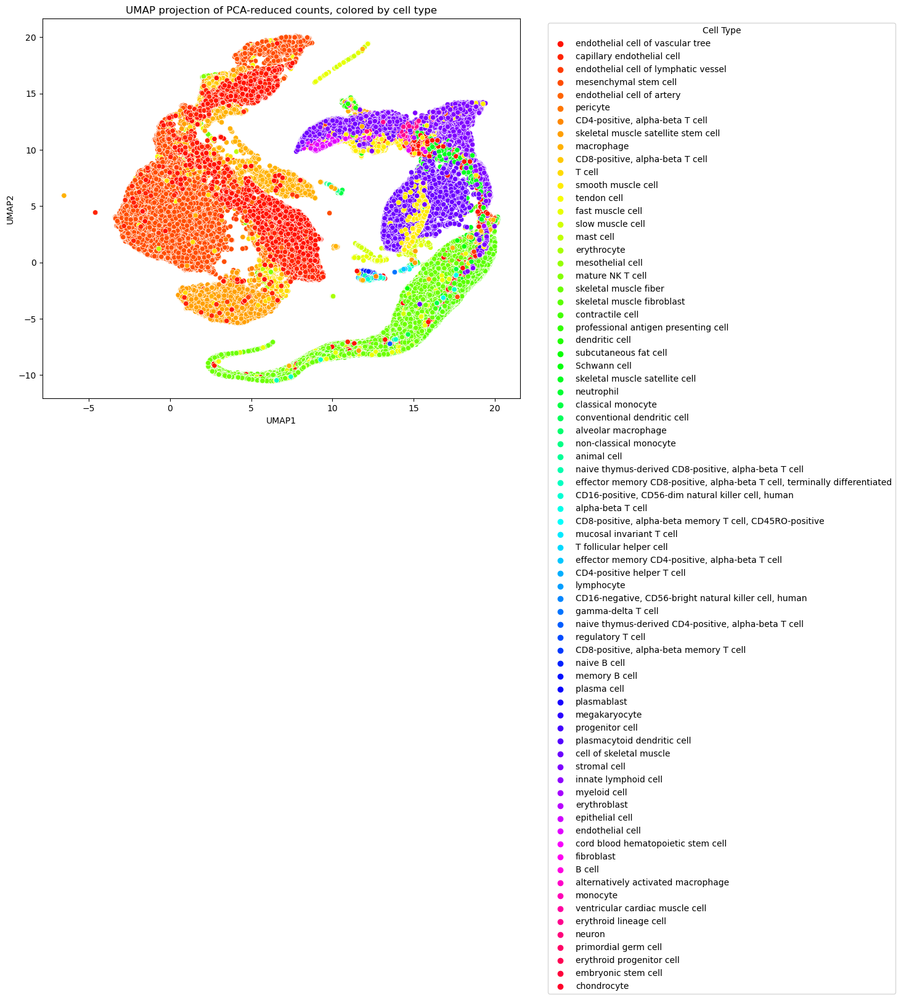

In [116]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import umap
import pandas as pd

# Assuming `adata` is your AnnData object with counts in adata.X 
# and cell types in adata.obs["cell_type"]

# Convert sparse matrix to dense format if your data size allows
dense_counts = adata.X.toarray()  # Only if adata.X is a sparse matrix

# Step 1: Apply PCA for dimensionality reduction on dense counts
pca = PCA(n_components=50)  # Adjust the number of components as needed
pca_counts = pca.fit_transform(dense_counts)

# Step 2: Compute UMAP projections on PCA-reduced data
reducer = umap.UMAP()
umap_counts = reducer.fit_transform(pca_counts)

# Step 3: Create a DataFrame for easier plotting
df = pd.DataFrame(umap_counts, columns=['UMAP1', 'UMAP2'])
df['cell_type'] = adata.obs["cell_type"].values

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="cell_type", palette=sns.color_palette("hsv", len(df['cell_type'].unique())), data=df)
plt.title('UMAP projection of PCA-reduced counts, colored by cell type')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import umap
import pandas as pd

# Assuming `adata` is your AnnData object with counts in adata.X 
# and cell types in adata.obs["cell_type"]

# Convert sparse matrix to dense format if your data size allows
dense_counts = adata.X.toarray()  # Only if adata.X is a sparse matrix

# Step 1: Apply PCA for dimensionality reduction on dense counts
pca = PCA(n_components=1000)  # Adjust the number of components as needed
pca_counts = pca.fit_transform(dense_counts)

# Step 2: Compute UMAP projections on PCA-reduced data
reducer = umap.UMAP()
umap_counts = reducer.fit_transform(dense_counts)

# Step 3: Create a DataFrame for easier plotting
df = pd.DataFrame(umap_counts, columns=['UMAP1', 'UMAP2'])
df['cell_type'] = adata.obs["cell_type"].values

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="cell_type", palette=sns.color_palette("hsv", len(df['cell_type'].unique())), data=df)
plt.title('UMAP projection of PCA-reduced counts, colored by cell type')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


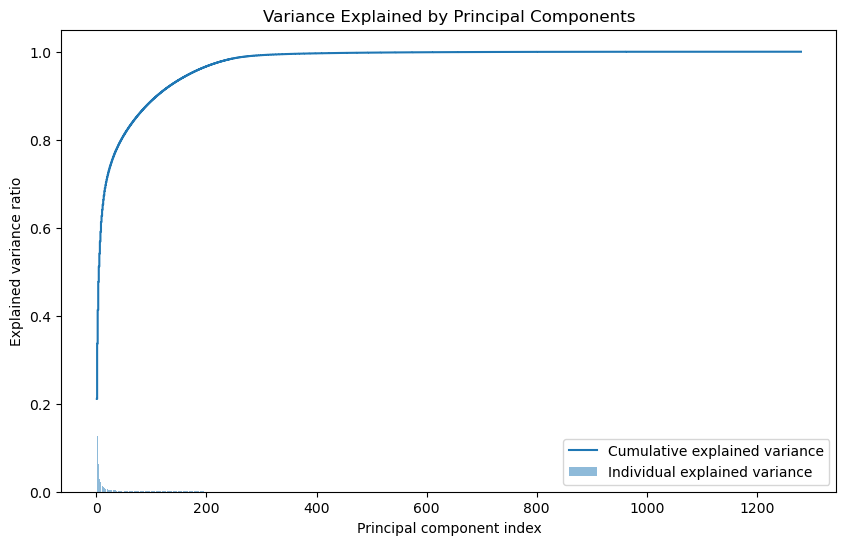

In [95]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Assuming `adata` is your Anndata object with embeddings in adata.obsm["emb"]

# Perform PCA
pca = PCA()
pca.fit(adata.obsm["emb"])

# Variance explained by each PC
explained_variance = pca.explained_variance_ratio_

# Plotting
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(1, len(explained_variance) + 1), explained_variance.cumsum(), where='mid', label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.title('Variance Explained by Principal Components')
plt.show()


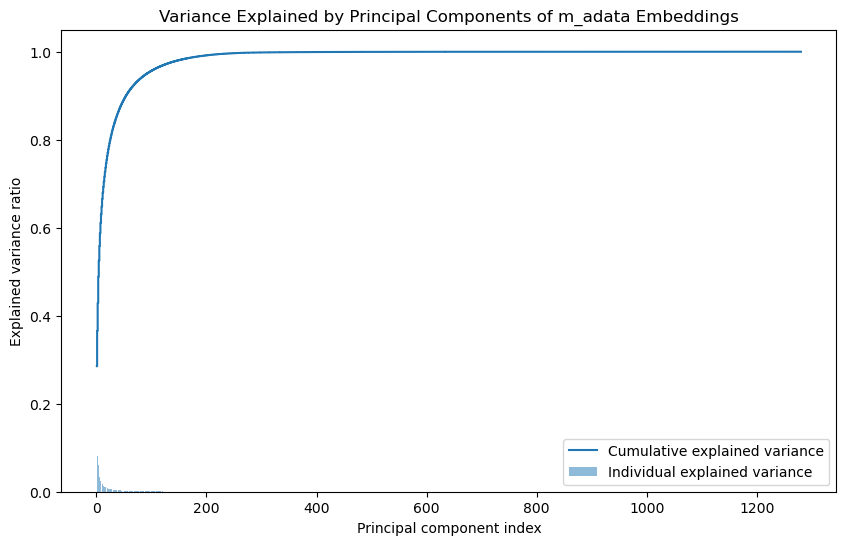

In [96]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Assuming `m_adata` is your Anndata object with embeddings in m_adata.obsm["X_uce"]

# Perform PCA on m_adata embeddings
pca = PCA()
pca.fit(m_adata.obsm["X_uce"])

# Variance explained by each PC
explained_variance = pca.explained_variance_ratio_

# Plotting the variance
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(1, len(explained_variance) + 1), explained_variance.cumsum(), where='mid', label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.title('Variance Explained by Principal Components of m_adata Embeddings')
plt.show()


PCA done for 500


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

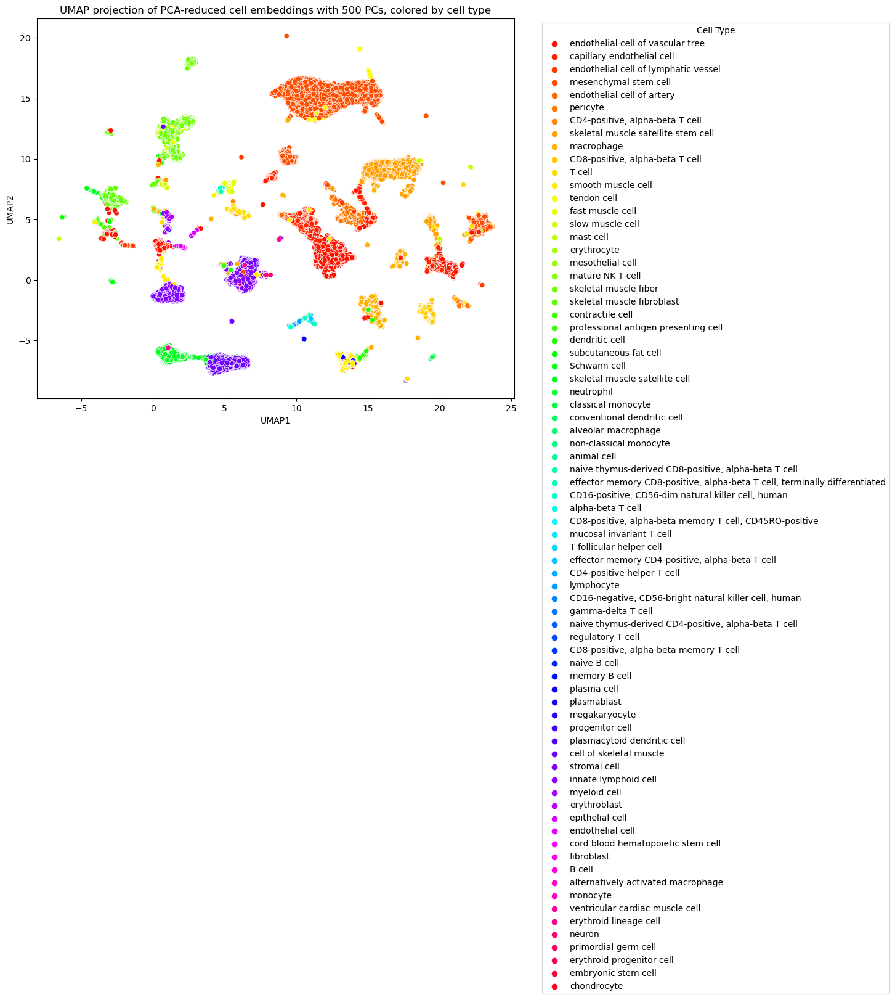

PCA done for 200


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

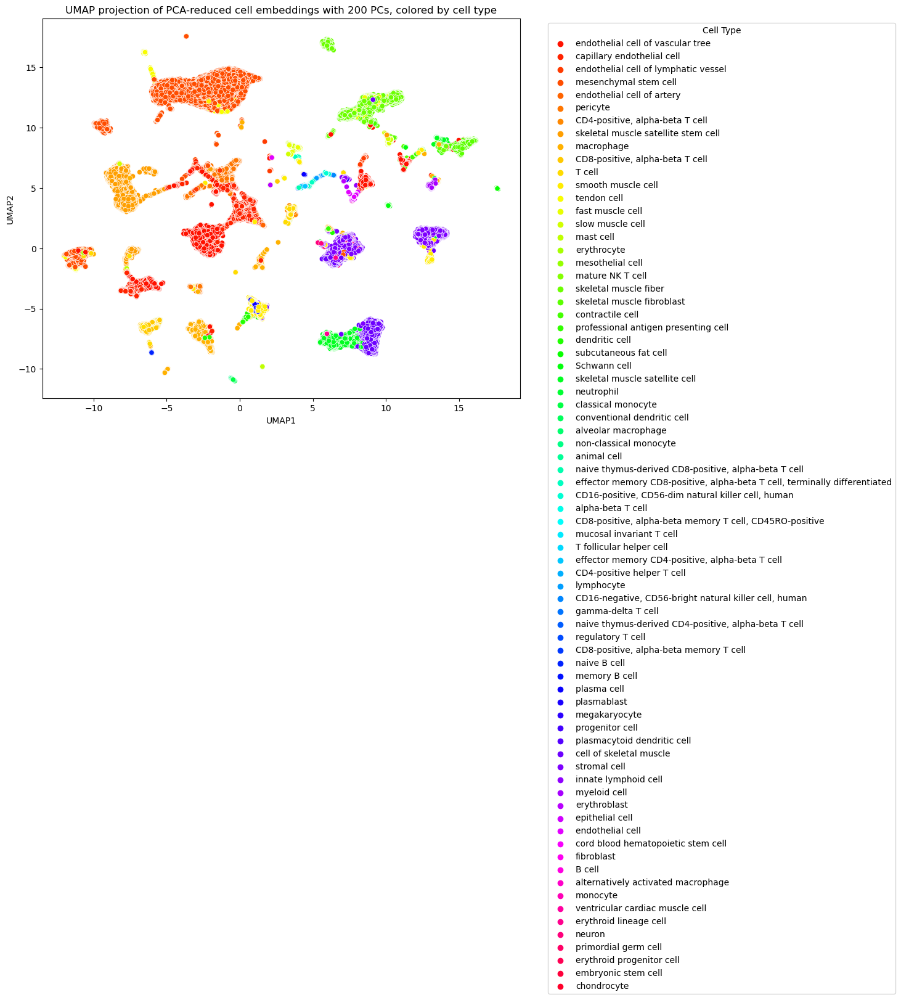

PCA done for 100


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

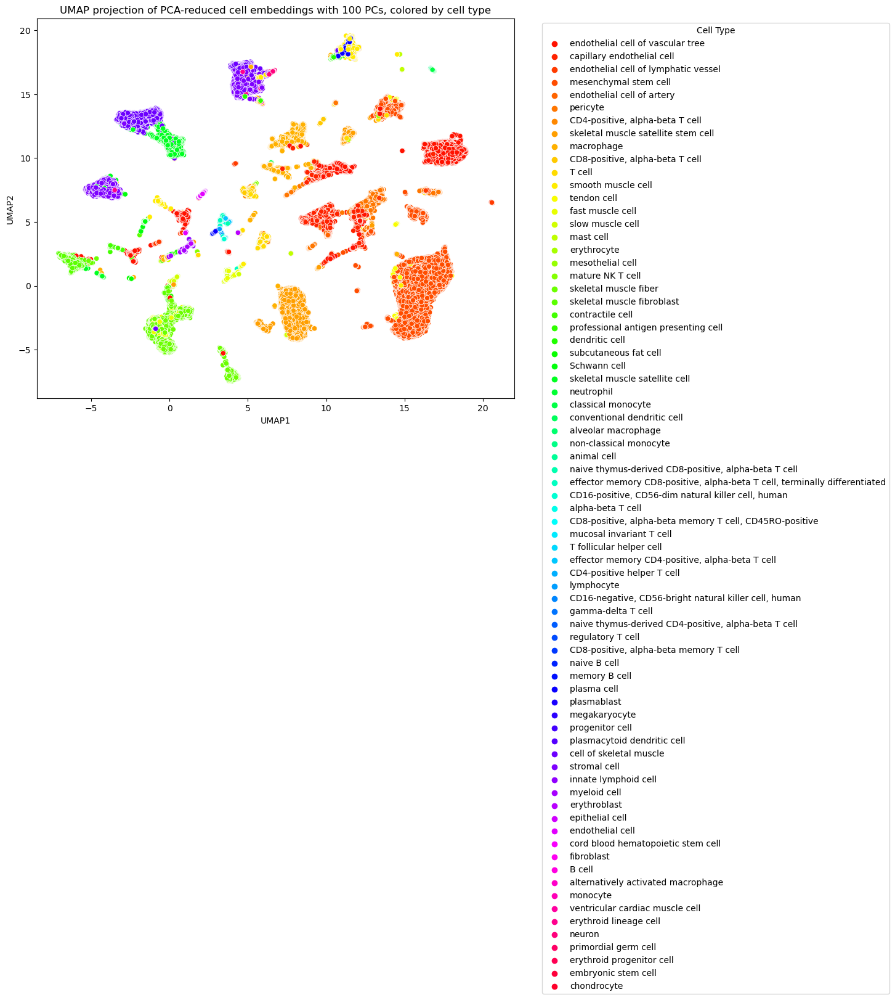

PCA done for 50


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

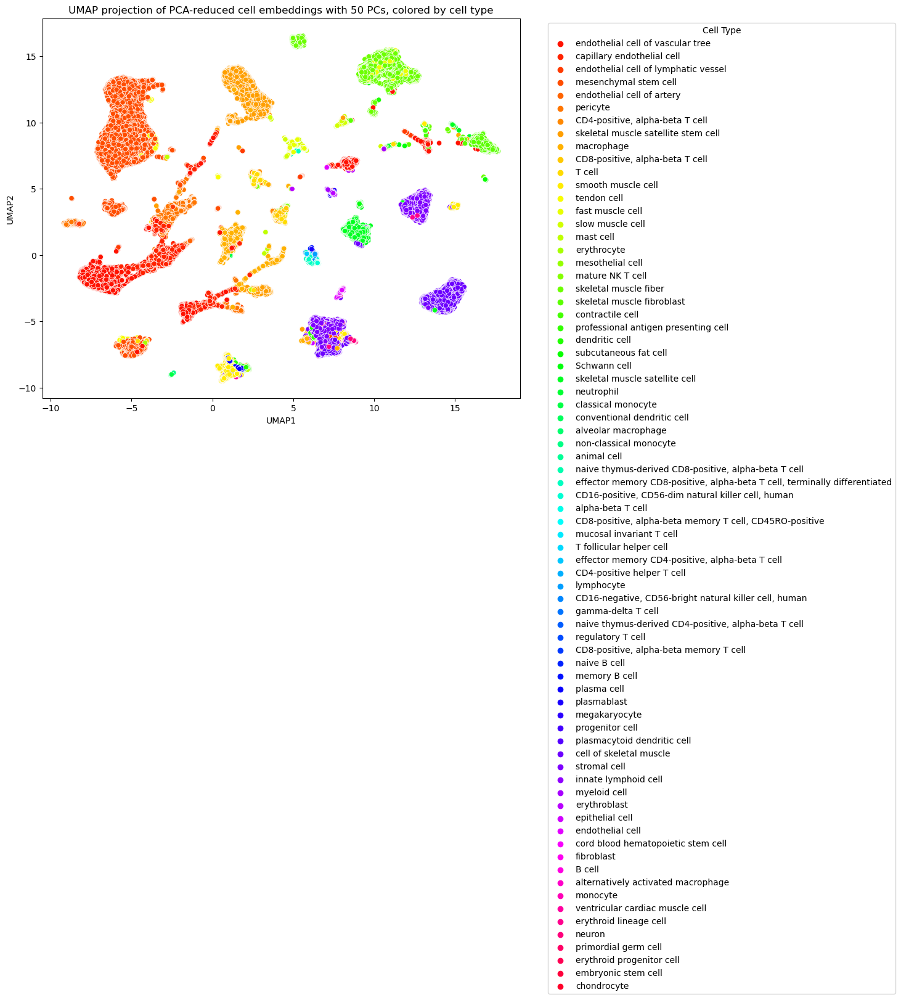

PCA done for 20


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

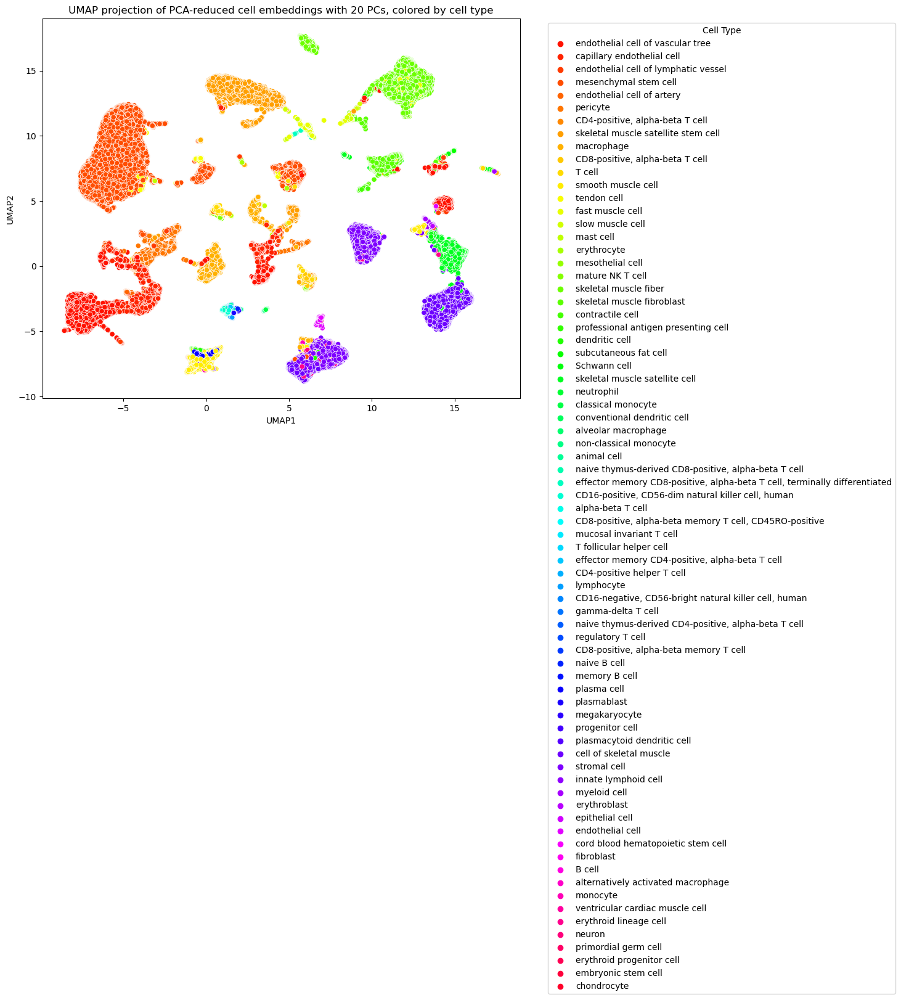

PCA done for 10


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

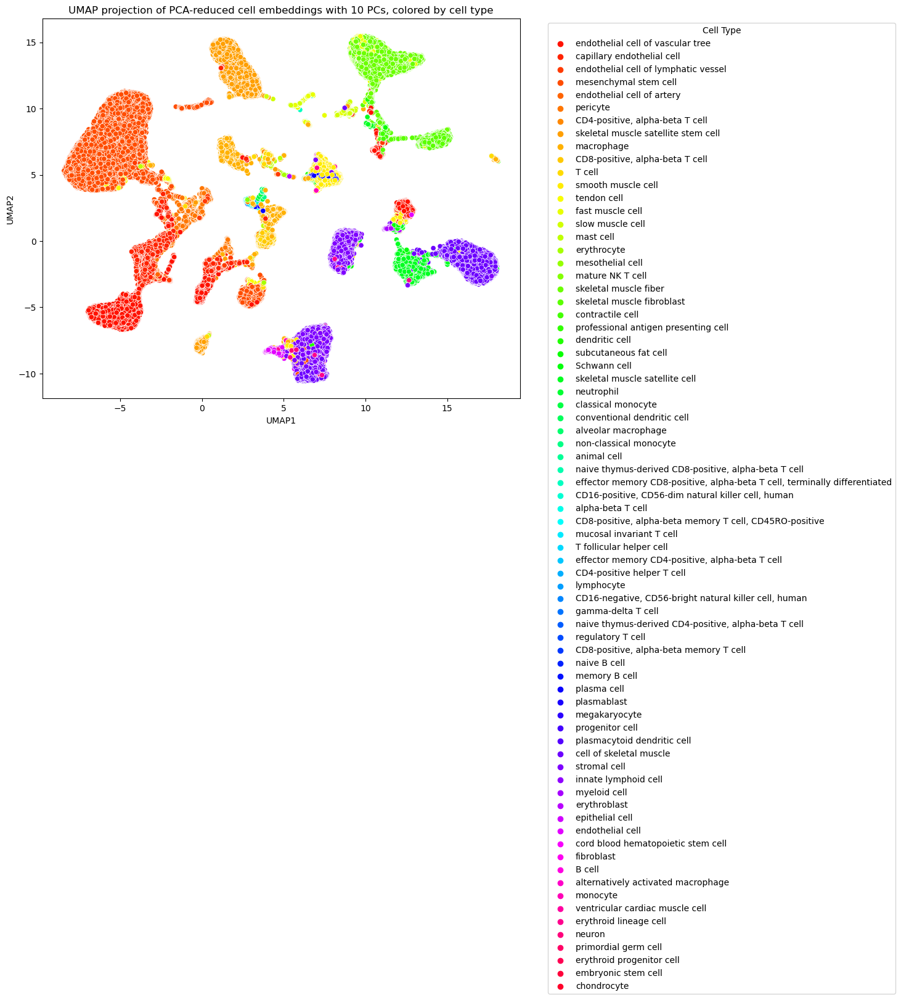

PCA done for 5


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

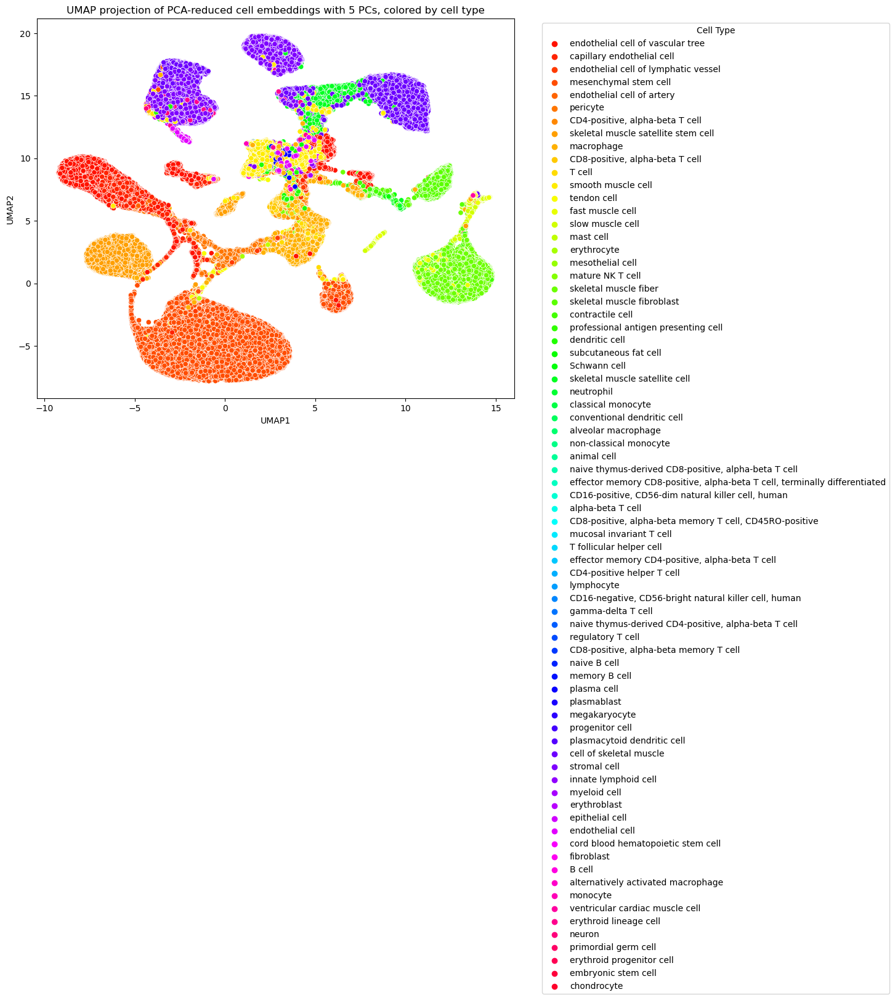

PCA done for 3


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

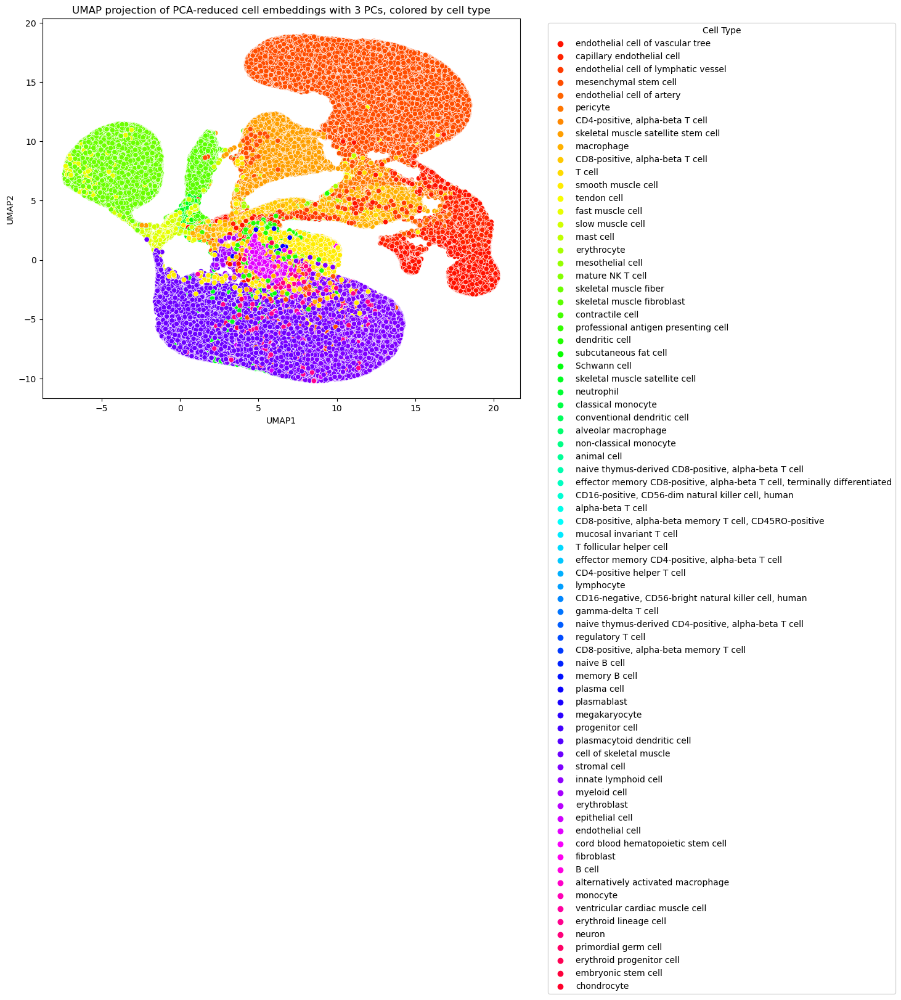

PCA done for 2


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

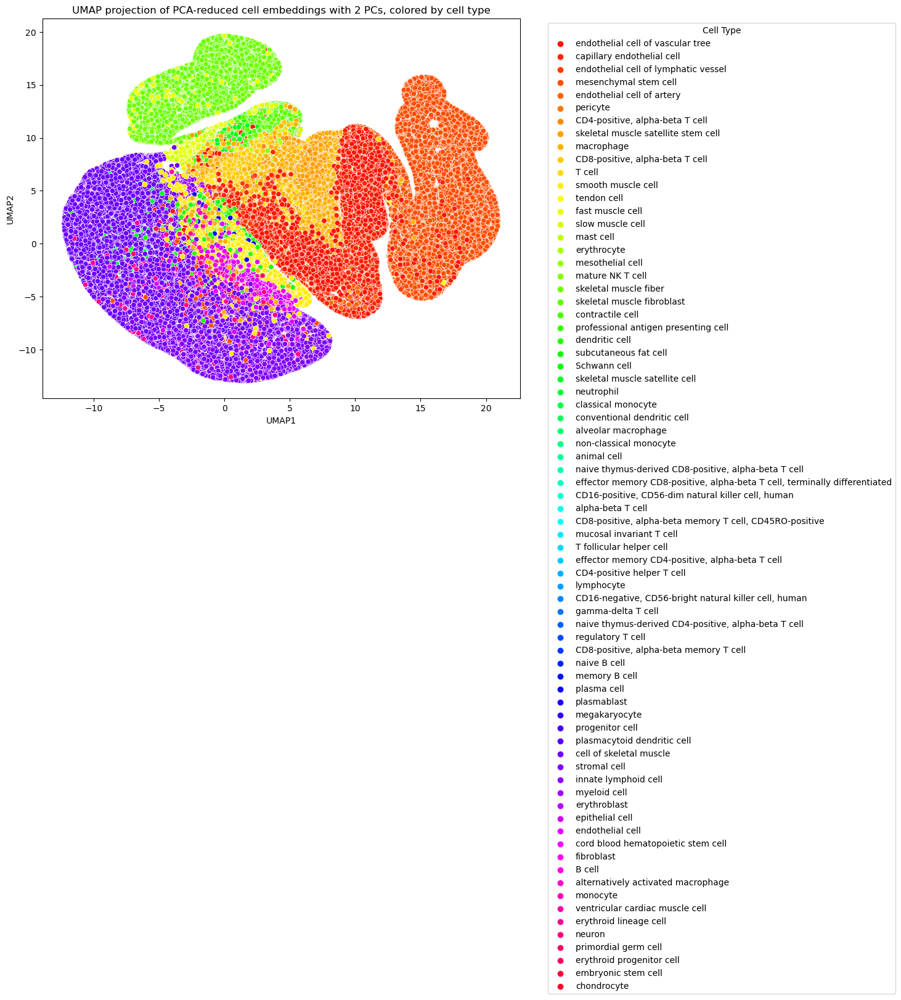

In [102]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import umap
import pandas as pd

# Assuming `adata` is your Anndata object with embeddings in adata.obsm["emb"] 
# and cell types in adata.obs["cell_type"]

# Number of components to iterate over
components_list = [500, 200, 100, 50, 20, 10, 5, 3, 2]

for n_components in components_list:
    # Apply PCA for dimensionality reduction
    pca = PCA(n_components=n_components)
    pca_embeddings = pca.fit_transform(adata.obsm["emb"])
    print("PCA done for", n_components)
    # Compute UMAP projections on PCA-reduced data
    reducer = umap.UMAP()
    umap_embeddings = reducer.fit_transform(pca_embeddings)
    
    # Create a DataFrame for easier plotting
    df = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
    df['cell_type'] = adata.obs["cell_type"].values
    
    # Plotting
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x="UMAP1", y="UMAP2", hue="cell_type", 
                    palette=sns.color_palette("hsv", len(df['cell_type'].unique())), data=df)
    plt.title(f'UMAP projection of PCA-reduced cell embeddings with {n_components} PCs, colored by cell type')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


In [103]:
import cellxgene_census

with cellxgene_census.open_soma() as census:
    # Query a subset of cell metadata
    cell_metadata = census["census_data"]["homo_sapiens"].obs.read(
        column_names=["tissue_general"]
    )
    # Concatenate results to a table
    cell_metadata = cell_metadata.concat()
    # Convert to pandas DataFrame
    cell_metadata = cell_metadata.to_pandas()
    # Get unique tissue_general values
    unique_tissue_generals = cell_metadata["tissue_general"].unique()
    print(unique_tissue_generals)

The "stable" release is currently 2023-12-15. Specify 'census_version="2023-12-15"' in future calls to open_soma() to ensure data consistency.


['brain' 'heart' 'blood' 'mucosa' 'embryo' 'small intestine' 'breast'
 'placenta' 'adrenal gland' 'kidney' 'adipose tissue' 'vasculature'
 'lymph node' 'pancreas' 'exocrine gland' 'bladder organ'
 'respiratory system' 'prostate gland' 'spleen' 'eye' 'large intestine'
 'uterus' 'liver' 'tongue' 'bone marrow' 'musculature' 'lung'
 'endocrine gland' 'skin of body' 'central nervous system' 'spinal cord'
 'nose' 'reproductive system' 'colon' 'esophagus' 'stomach'
 'esophagogastric junction' 'immune system' 'ovary' 'fallopian tube'
 'yolk sac' 'digestive system' 'pleural fluid' 'axilla' 'skeletal system'
 'omentum' 'lamina propria' 'saliva' 'intestine' 'pleura' 'ureter'
 'testis' 'gallbladder']


In [105]:
import pandas as pd

# Filter m_adata to keep only entries with "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"]

# Assuming 'UMAP1' and 'UMAP2' are stored in the .obsm attribute of the filtered_m_adata
# and 'predicted.pheno' is in .obs
# You might need to adjust these lines depending on your actual data structure
df_m_adata_filtered = pd.DataFrame({
    'UMAP1': filtered_m_adata.obsm['X_umap'][:, 0],
    'UMAP2': filtered_m_adata.obsm['X_umap'][:, 1],
    'Type': filtered_m_adata.obs['predicted.pheno'],
    'Source': 'm_adata'  # Assuming you want to distinguish this in the combined plot
})

# Ensure distinct non-continuous colors for 'predicted.pheno' in the filtered DataFrame
unique_phenos_filtered = df_m_adata_filtered['Type'].nunique()
palette_filtered = sns.color_palette('Set1', n_colors=unique_phenos_filtered)

# Combine df_adata with the filtered df_m_adata
df_combined_filtered = pd.concat([df_adata, df_m_adata_filtered], ignore_index=True)

# Plotting code remains the same...


KeyError: 'X_umap'

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

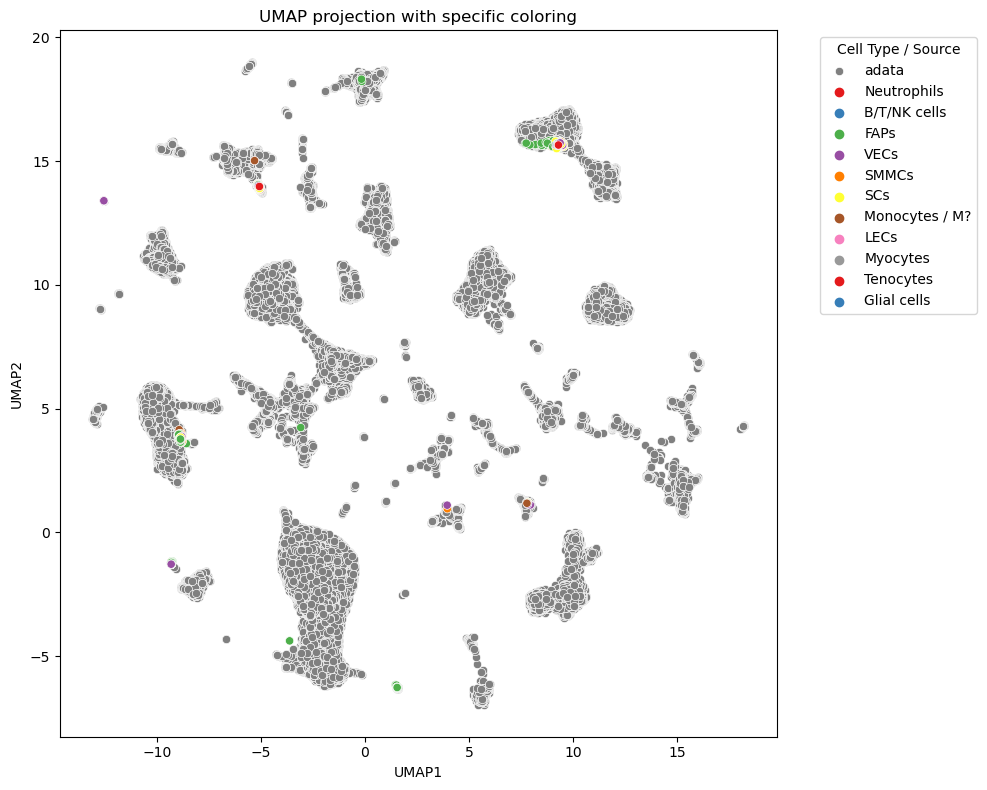

In [106]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming `adata` is your Anndata object with original embeddings
# and `m_adata` is another Anndata object with embeddings in m_adata.obsm["X_uce"]

# Compute UMAP projections for both datasets using a single UMAP model
reducer = umap.UMAP()
umap_embeddings_adata = reducer.fit_transform(adata.obsm["emb"])

# Filter m_adata based on "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"]

# Compute UMAP for filtered m_adata using the same reducer
umap_embeddings_m_adata_filtered = reducer.transform(filtered_m_adata.obsm["X_uce"])

# Create a DataFrame for adata for easier plotting
df_adata = pd.DataFrame(umap_embeddings_adata, columns=['UMAP1', 'UMAP2'])
df_adata['Type'] = 'adata'  # All adata embeddings have the same type
df_adata['Source'] = 'adata'

# Create a DataFrame for filtered m_adata
df_m_adata_filtered = pd.DataFrame(umap_embeddings_m_adata_filtered, columns=['UMAP1', 'UMAP2'])
df_m_adata_filtered['Type'] = filtered_m_adata.obs["predicted.pheno"].values  # Using predicted phenotype for coloring
df_m_adata_filtered['Source'] = 'm_adata'

# Combine both DataFrames
df_combined = pd.concat([df_adata, df_m_adata_filtered], ignore_index=True)

# Plotting
plt.figure(figsize=(10, 8))
# Plot adata embeddings with a single color
sns.scatterplot(data=df_combined[df_combined['Source'] == 'adata'], x='UMAP1', y='UMAP2', color='grey', label='adata')
# Plot filtered m_adata embeddings colored by predicted phenotype
# Using a distinct color palette, like 'Set1', for predicted phenotypes
palette = sns.color_palette('Set1', n_colors=len(df_m_adata_filtered['Type'].unique()))
sns.scatterplot(data=df_combined[df_combined['Source'] == 'm_adata'], x='UMAP1', y='UMAP2', hue='Type', palette=palette)

plt.title('UMAP projection with specific coloring')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type / Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


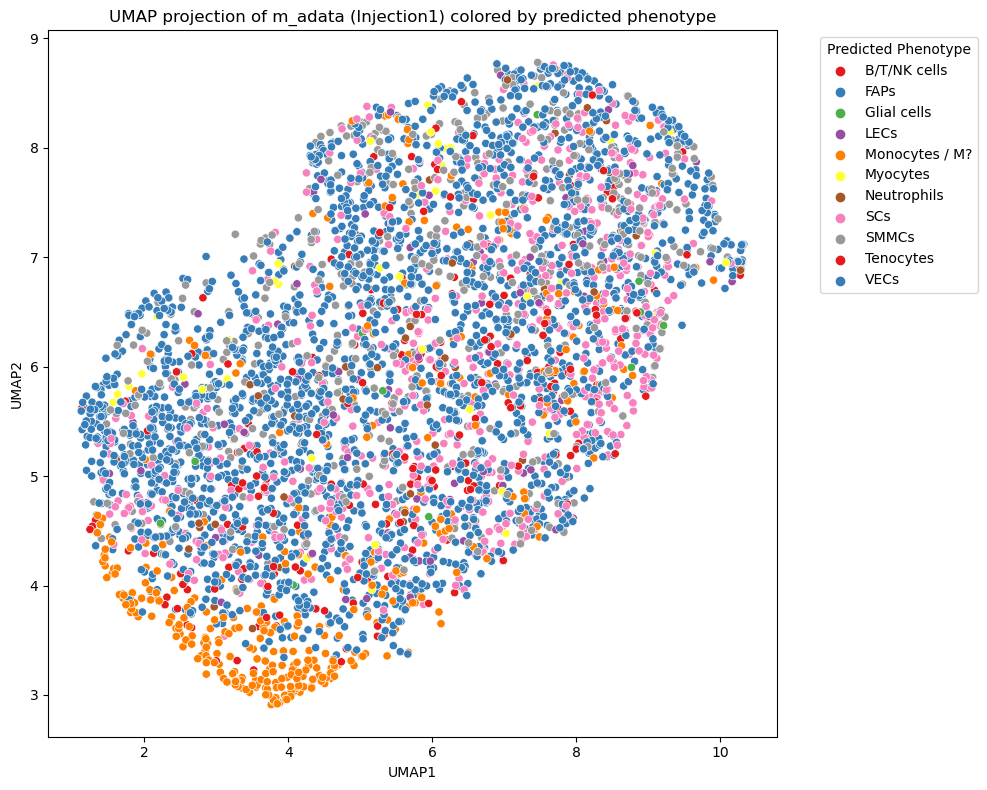

In [107]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Assuming `m_adata` is your Anndata object with embeddings in m_adata.obsm["X_uce"]

# Filter m_adata based on "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"]

# Compute UMAP projections for filtered m_adata
reducer = umap.UMAP()
umap_embeddings_m_adata_filtered = reducer.fit_transform(filtered_m_adata.obsm["X_uce"])

# Create a DataFrame for filtered m_adata
df_m_adata_filtered = pd.DataFrame(umap_embeddings_m_adata_filtered, columns=['UMAP1', 'UMAP2'])
df_m_adata_filtered['PredictedPheno'] = filtered_m_adata.obs["predicted.pheno"].values  # Use predicted phenotype for coloring

# Plotting
plt.figure(figsize=(10, 8))
# Use a distinct color palette, like 'Set1', for predicted phenotypes
palette = sns.color_palette('Set1', n_colors=len(df_m_adata_filtered['PredictedPheno'].unique()))
sns.scatterplot(data=df_m_adata_filtered, x='UMAP1', y='UMAP2', hue='PredictedPheno', palette=palette)

plt.title('UMAP projection of m_adata (Injection1) colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


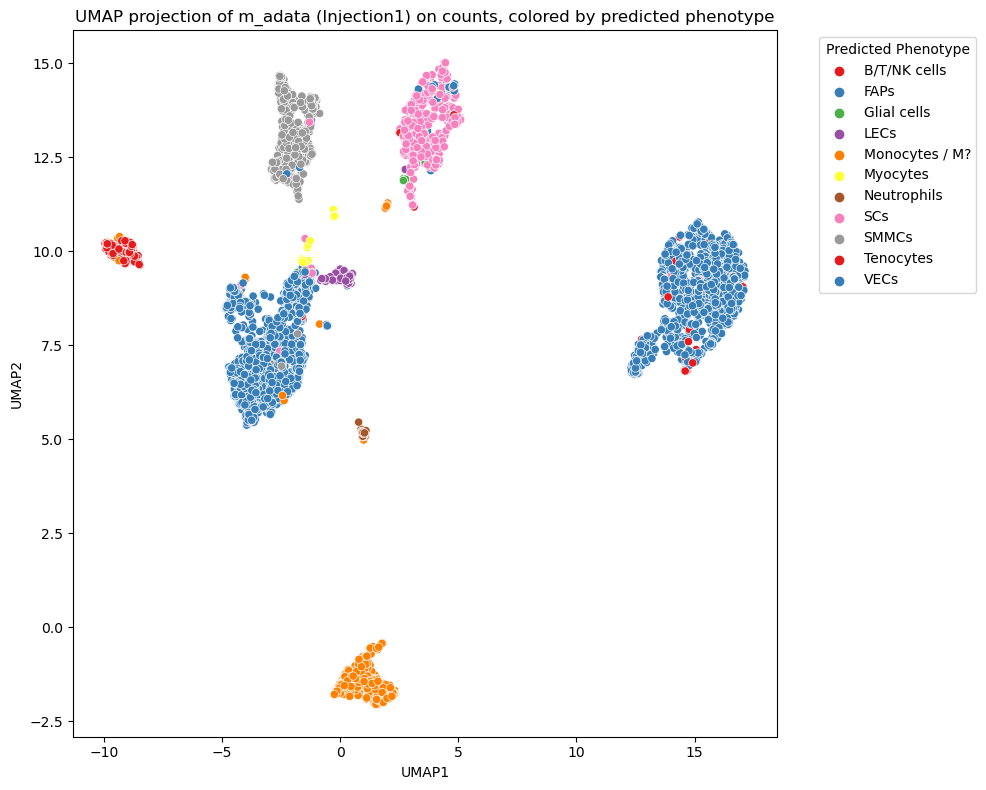

In [108]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd
import scanpy as sc

# Assuming `m_adata` is your Anndata object with count data in m_adata.X

# Filter m_adata based on "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"].copy()

# Preprocessing steps
# Normalizing the data to total counts per cell
#sc.pp.normalize_total(filtered_m_adata, target_sum=1e4)

# Logarithmizing the data
#sc.pp.log1p(filtered_m_adata)

# Running UMAP on the preprocessed count data
reducer = umap.UMAP()
umap_embeddings = reducer.fit_transform(filtered_m_adata.X)

# Creating a DataFrame for plotting
df_umap = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
df_umap['PredictedPheno'] = filtered_m_adata.obs["predicted.pheno"].values

# Plotting
plt.figure(figsize=(10, 8))
# Use a distinct color palette for predicted phenotypes
palette = sns.color_palette('Set1', n_colors=len(df_umap['PredictedPheno'].unique()))
sns.scatterplot(data=df_umap, x='UMAP1', y='UMAP2', hue='PredictedPheno', palette=palette)

plt.title('UMAP projection of m_adata (Injection1) on counts, colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


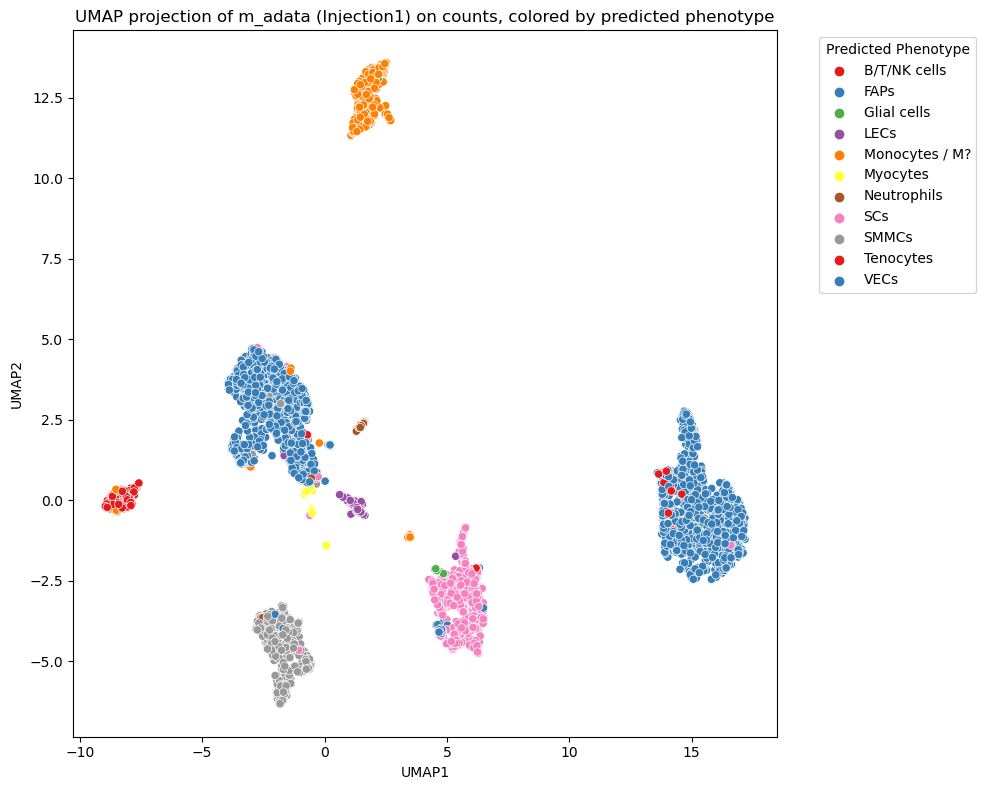

In [109]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd
import scanpy as sc

# Assuming `m_adata` is your Anndata object with count data in m_adata.X

# Filter m_adata based on "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"].copy()

# Preprocessing steps
# Normalizing the data to total counts per cell
sc.pp.normalize_total(filtered_m_adata, target_sum=1e4)

# Logarithmizing the data
#sc.pp.log1p(filtered_m_adata)

# Running UMAP on the preprocessed count data
reducer = umap.UMAP()
umap_embeddings = reducer.fit_transform(filtered_m_adata.X)

# Creating a DataFrame for plotting
df_umap = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
df_umap['PredictedPheno'] = filtered_m_adata.obs["predicted.pheno"].values

# Plotting
plt.figure(figsize=(10, 8))
# Use a distinct color palette for predicted phenotypes
palette = sns.color_palette('Set1', n_colors=len(df_umap['PredictedPheno'].unique()))
sns.scatterplot(data=df_umap, x='UMAP1', y='UMAP2', hue='PredictedPheno', palette=palette)

plt.title('UMAP projection of m_adata (Injection1) on counts, colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


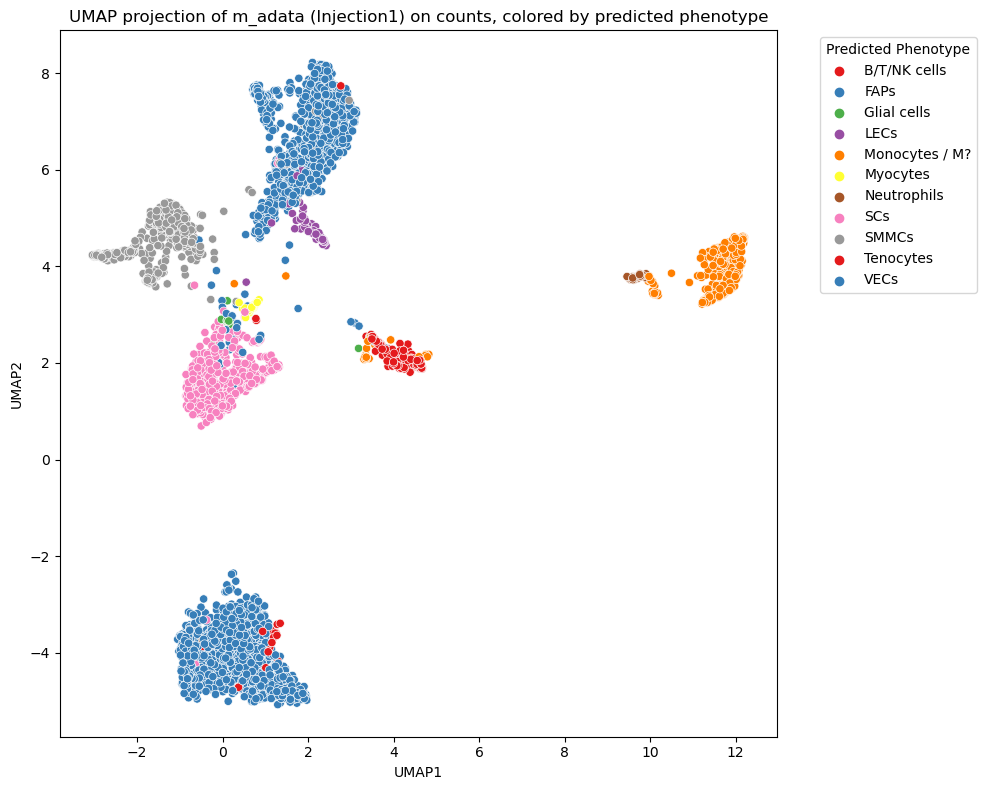

In [110]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd
import scanpy as sc

# Assuming `m_adata` is your Anndata object with count data in m_adata.X

# Filter m_adata based on "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"].copy()

# Preprocessing steps
# Normalizing the data to total counts per cell
#sc.pp.normalize_total(filtered_m_adata, target_sum=1e4)

# Logarithmizing the data
sc.pp.log1p(filtered_m_adata)

# Running UMAP on the preprocessed count data
reducer = umap.UMAP()
umap_embeddings = reducer.fit_transform(filtered_m_adata.X)

# Creating a DataFrame for plotting
df_umap = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
df_umap['PredictedPheno'] = filtered_m_adata.obs["predicted.pheno"].values

# Plotting
plt.figure(figsize=(10, 8))
# Use a distinct color palette for predicted phenotypes
palette = sns.color_palette('Set1', n_colors=len(df_umap['PredictedPheno'].unique()))
sns.scatterplot(data=df_umap, x='UMAP1', y='UMAP2', hue='PredictedPheno', palette=palette)

plt.title('UMAP projection of m_adata (Injection1) on counts, colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


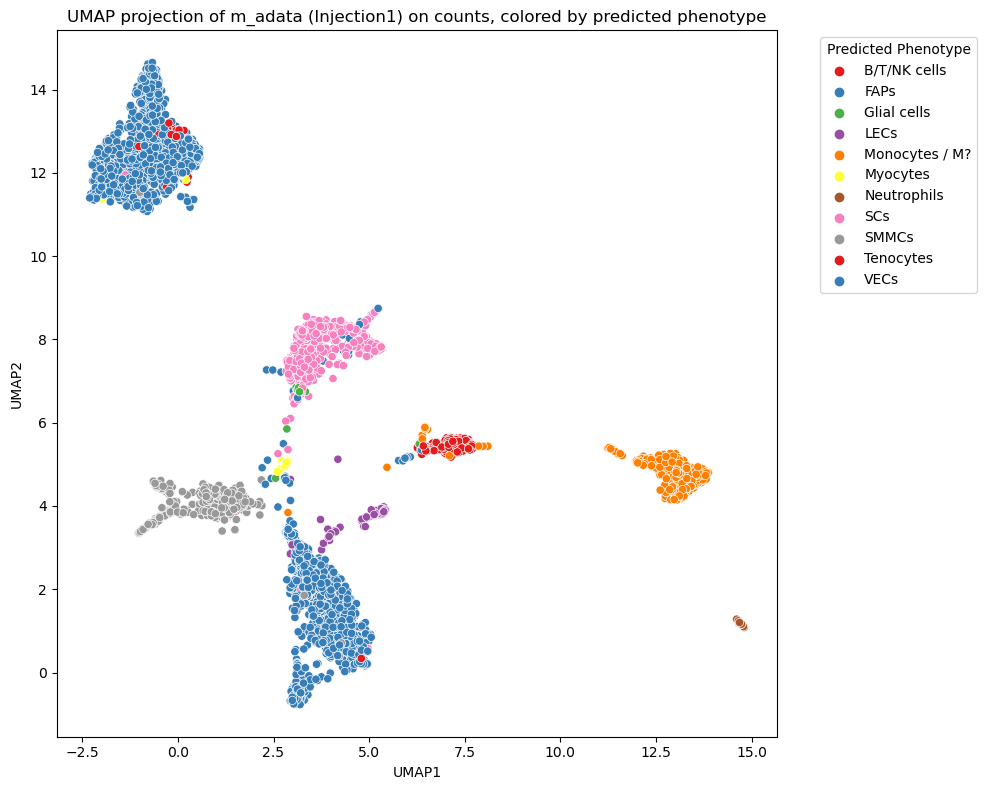

In [111]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd
import scanpy as sc

# Assuming `m_adata` is your Anndata object with count data in m_adata.X

# Filter m_adata based on "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"].copy()

# Preprocessing steps
# Normalizing the data to total counts per cell
sc.pp.normalize_total(filtered_m_adata, target_sum=1e4)

# Logarithmizing the data
sc.pp.log1p(filtered_m_adata)

# Running UMAP on the preprocessed count data
reducer = umap.UMAP()
umap_embeddings = reducer.fit_transform(filtered_m_adata.X)

# Creating a DataFrame for plotting
df_umap = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
df_umap['PredictedPheno'] = filtered_m_adata.obs["predicted.pheno"].values

# Plotting
plt.figure(figsize=(10, 8))
# Use a distinct color palette for predicted phenotypes
palette = sns.color_palette('Set1', n_colors=len(df_umap['PredictedPheno'].unique()))
sns.scatterplot(data=df_umap, x='UMAP1', y='UMAP2', hue='PredictedPheno', palette=palette)

plt.title('UMAP projection of m_adata (Injection1) on counts, colored by predicted phenotype')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


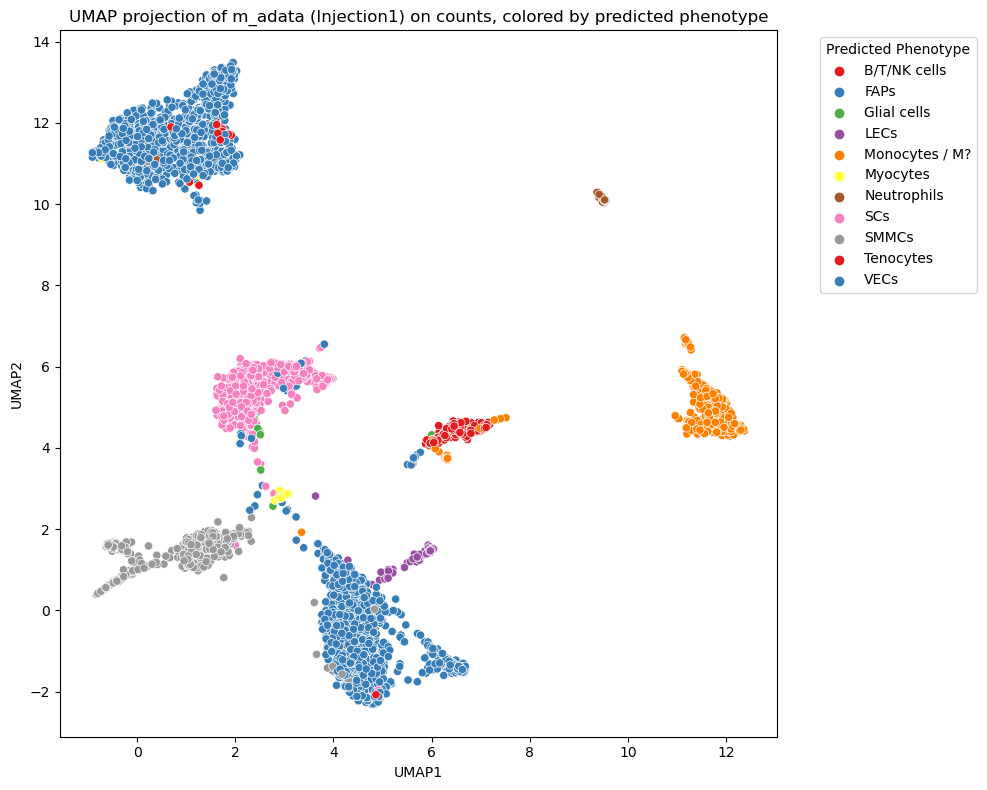

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


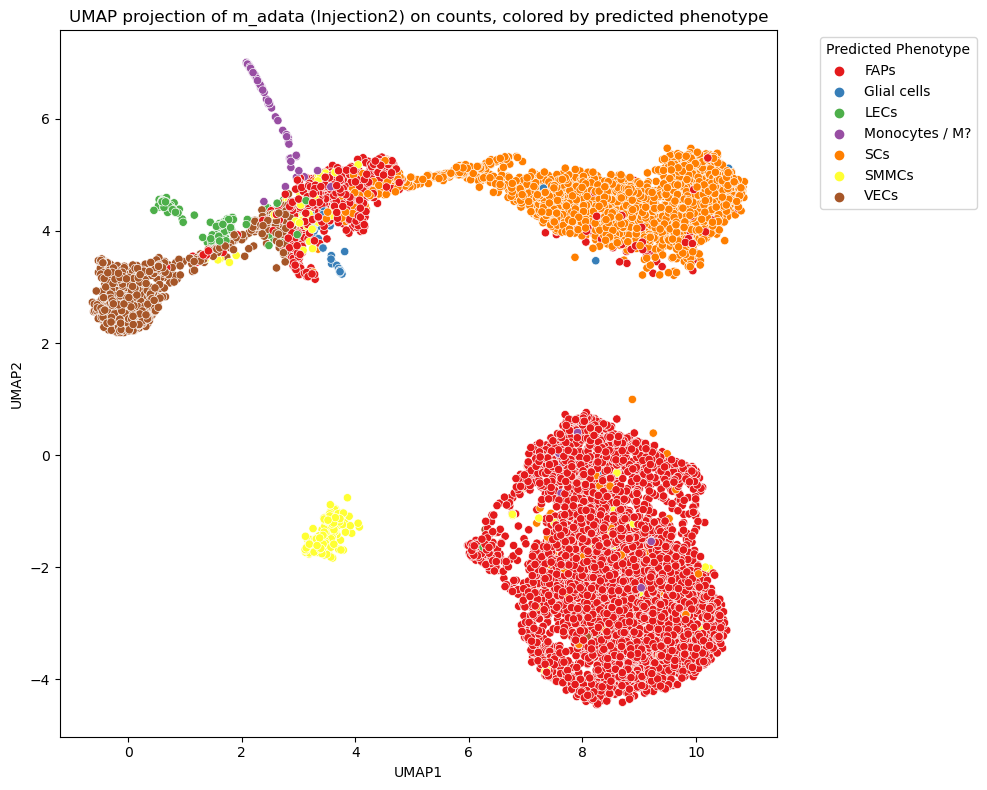

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


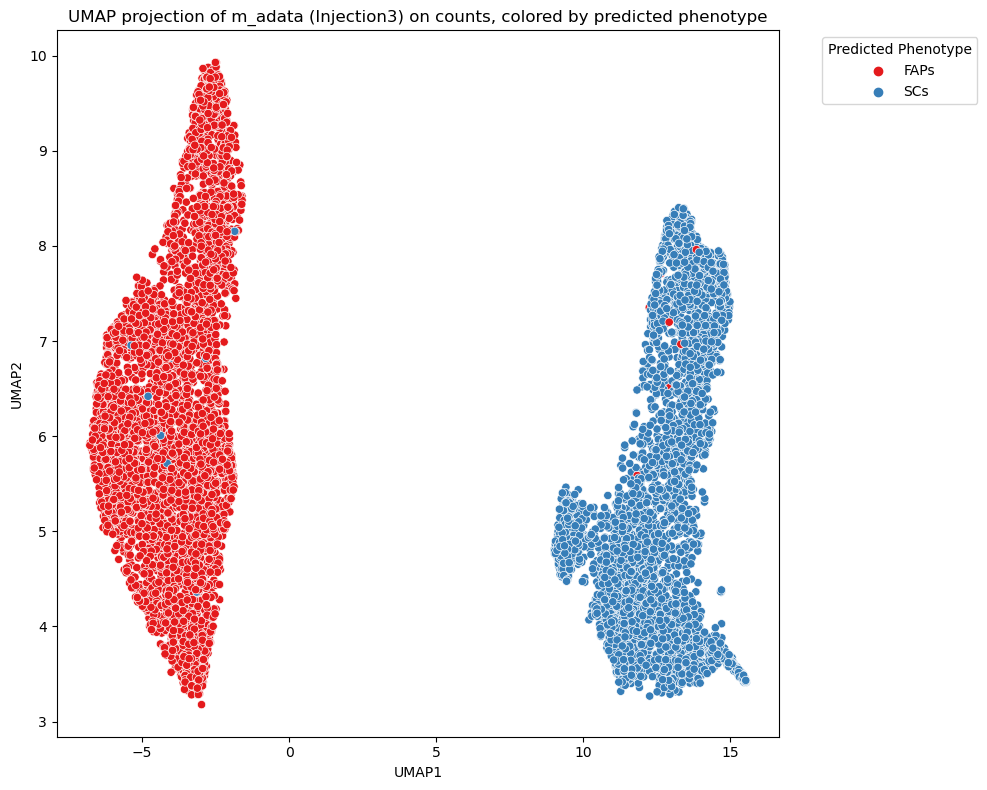

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


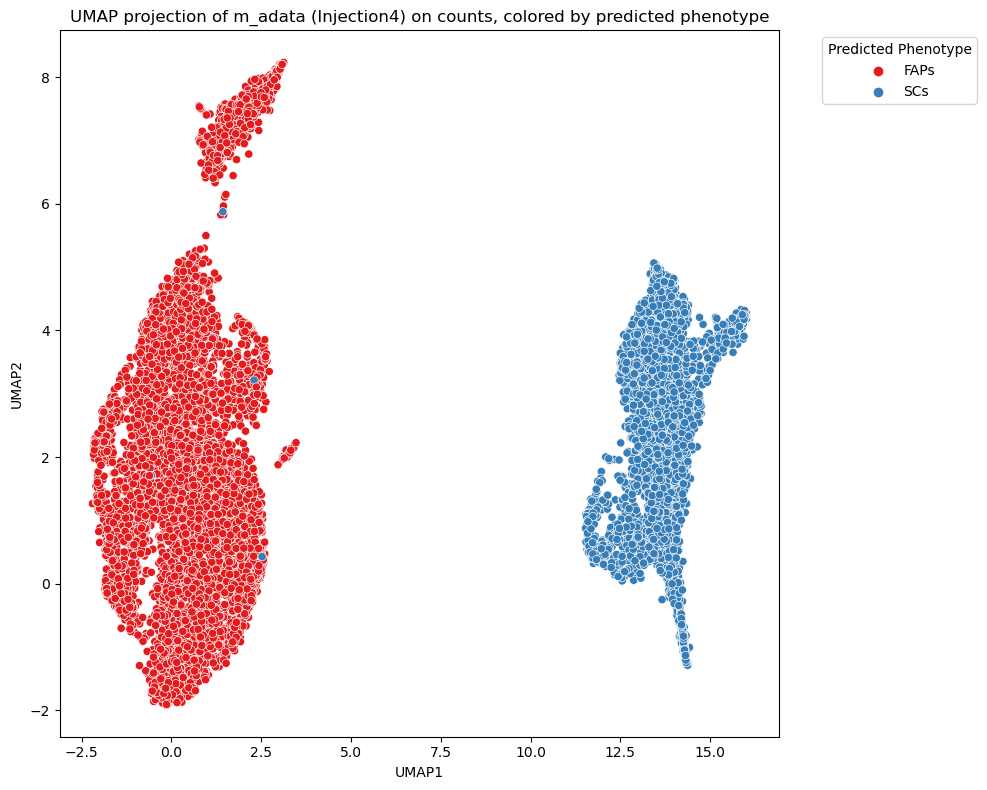

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


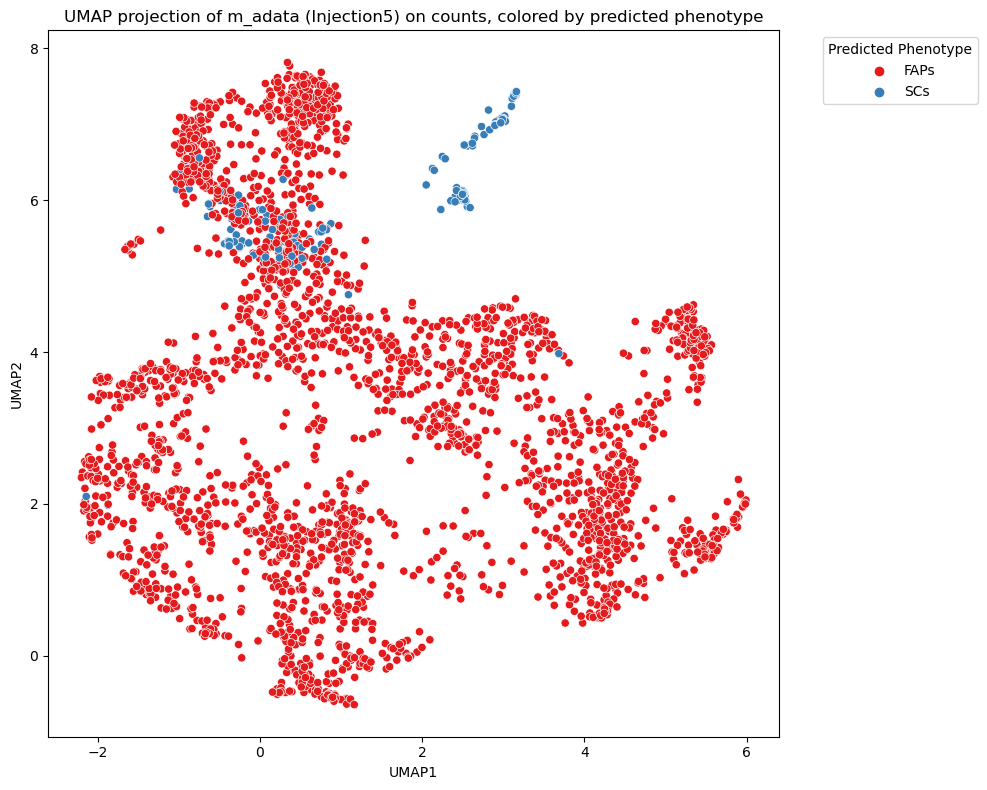

In [112]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd
import scanpy as sc

# Function to preprocess data and plot UMAP
def preprocess_and_plot_umap(adata, injection):
    filtered_adata = adata[adata.obs["orig.ident"] == injection].copy()
    
    # Normalizing the data to total counts per cell
    sc.pp.normalize_total(filtered_adata, target_sum=1e4)
    
    # Logarithmizing the data
    sc.pp.log1p(filtered_adata)
    
    # Running UMAP on the preprocessed count data
    reducer = umap.UMAP()
    umap_embeddings = reducer.fit_transform(filtered_adata.X)
    
    # Creating a DataFrame for plotting
    df_umap = pd.DataFrame(umap_embeddings, columns=['UMAP1', 'UMAP2'])
    df_umap['PredictedPheno'] = filtered_adata.obs["predicted.pheno"].values
    
    # Plotting
    plt.figure(figsize=(10, 8))
    palette = sns.color_palette('Set1', n_colors=len(df_umap['PredictedPheno'].unique()))
    sns.scatterplot(data=df_umap, x='UMAP1', y='UMAP2', hue='PredictedPheno', palette=palette)
    plt.title(f'UMAP projection of m_adata ({injection}) on counts, colored by predicted phenotype')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# Assuming `m_adata` is your Anndata object with count data in m_adata.X
# Iterate over each injection
for injection in ['Injection1', 'Injection2', 'Injection3', 'Injection4', 'Injection5']:
    preprocess_and_plot_umap(m_adata, injection)


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


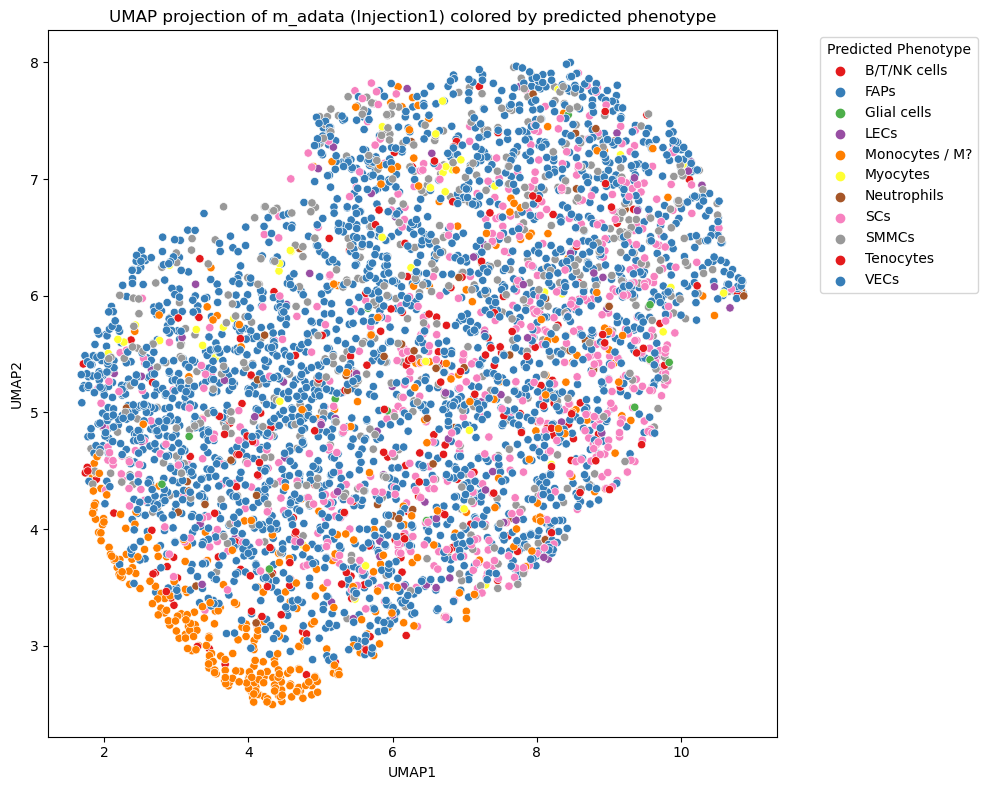

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


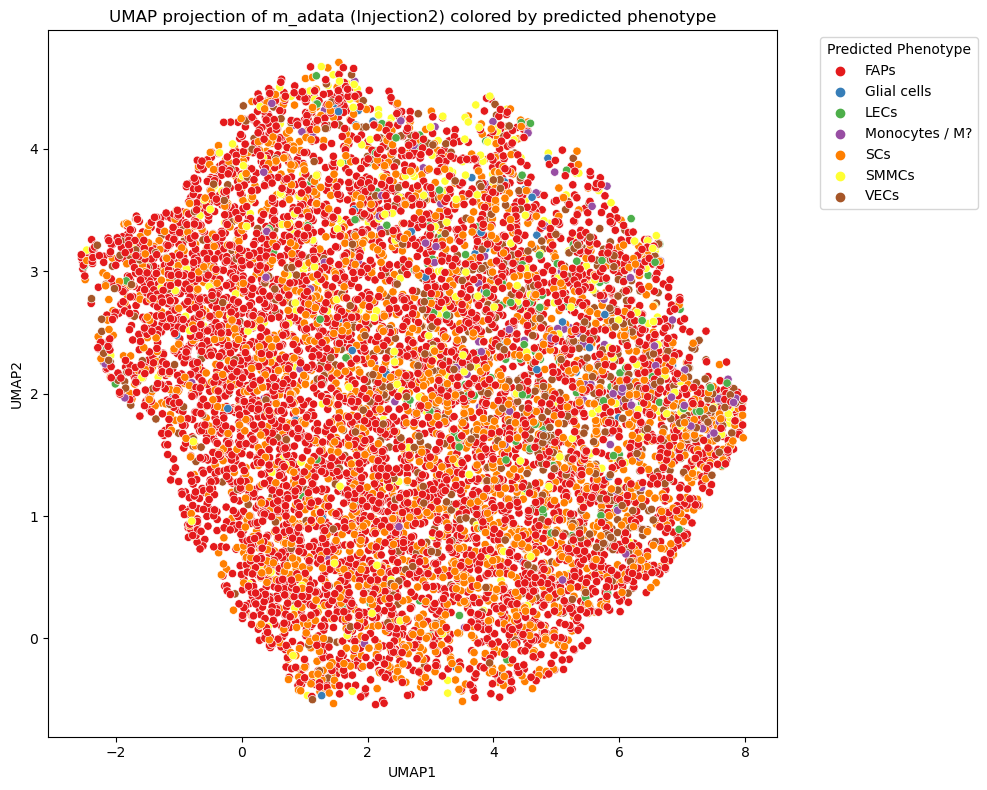

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


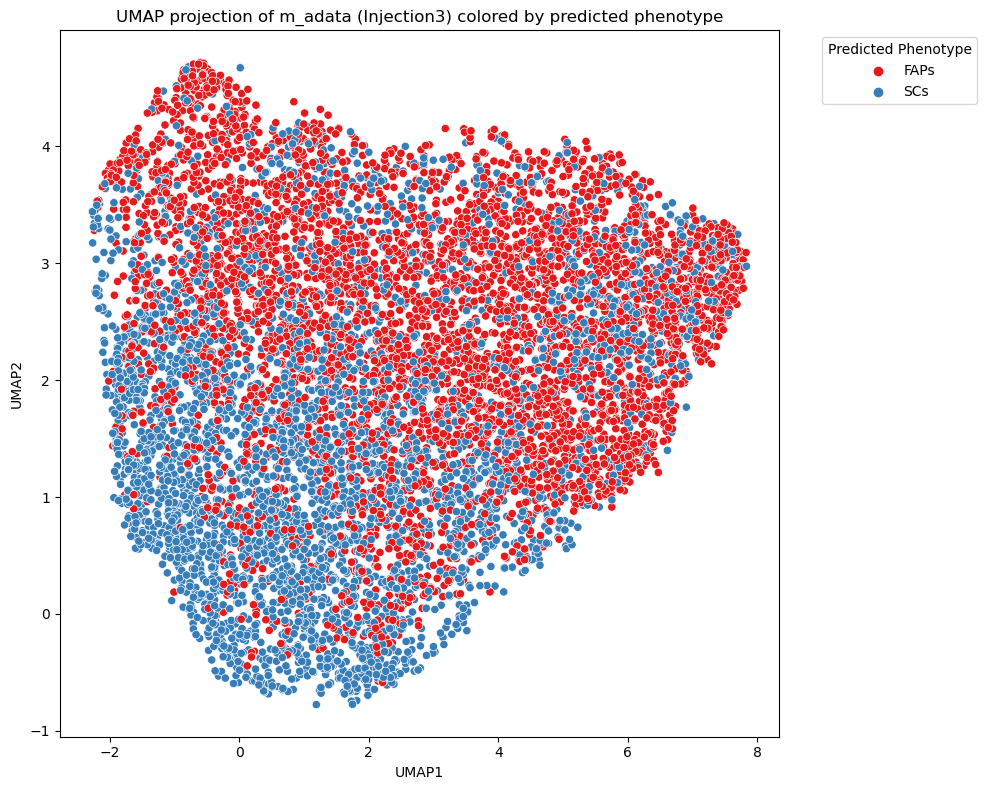

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


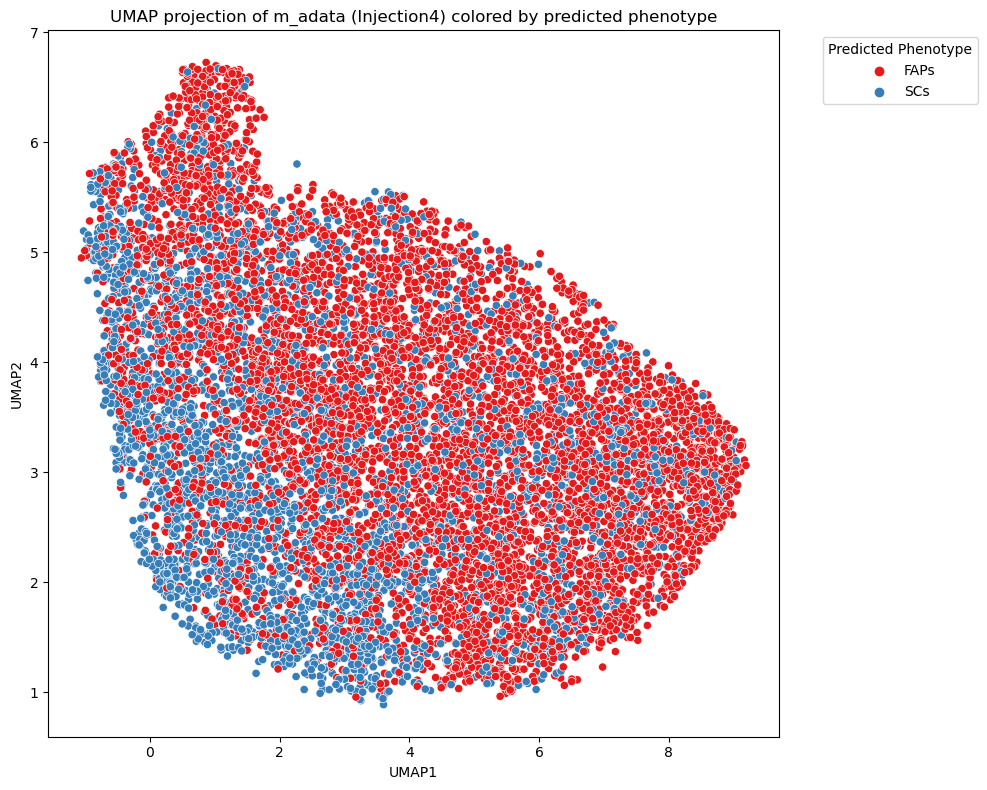

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


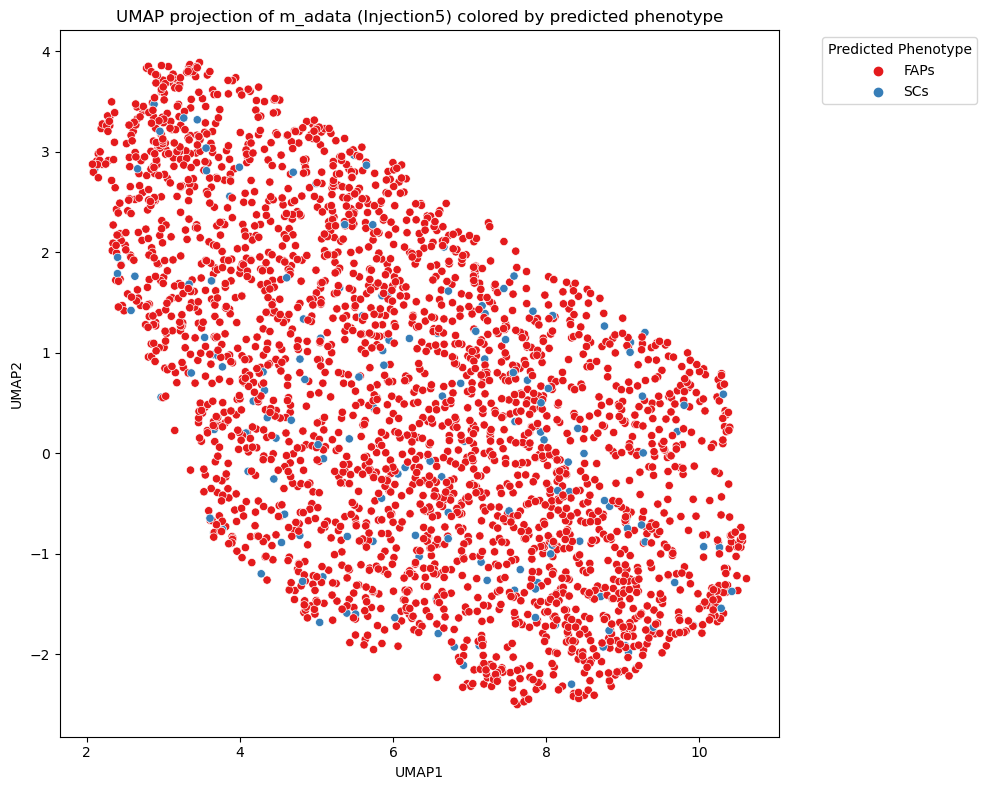

In [113]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd

# Function to filter data, compute UMAP, and plot for a given injection
def plot_umap_for_injection(adata, injection_id):
    # Filter m_adata based on "orig.ident" matching the injection_id
    filtered_m_adata = adata[adata.obs["orig.ident"] == injection_id]
    
    # Compute UMAP projections for filtered m_adata
    reducer = umap.UMAP()
    umap_embeddings_m_adata_filtered = reducer.fit_transform(filtered_m_adata.obsm["X_uce"])
    
    # Create a DataFrame for filtered m_adata
    df_m_adata_filtered = pd.DataFrame(umap_embeddings_m_adata_filtered, columns=['UMAP1', 'UMAP2'])
    df_m_adata_filtered['PredictedPheno'] = filtered_m_adata.obs["predicted.pheno"].values  # Use predicted phenotype for coloring
    
    # Plotting
    plt.figure(figsize=(10, 8))
    # Use a distinct color palette for predicted phenotypes
    palette = sns.color_palette('Set1', n_colors=len(df_m_adata_filtered['PredictedPheno'].unique()))
    sns.scatterplot(data=df_m_adata_filtered, x='UMAP1', y='UMAP2', hue='PredictedPheno', palette=palette)
    
    plt.title(f'UMAP projection of m_adata ({injection_id}) colored by predicted phenotype')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.legend(title='Predicted Phenotype', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

# Assuming `m_adata` is your Anndata object with embeddings in m_adata.obsm["X_uce"]

# Loop through each of the five injections and plot UMAP
for i in range(1, 6):
    injection_id = f'Injection{i}'
    plot_umap_for_injection(m_adata, injection_id)


/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

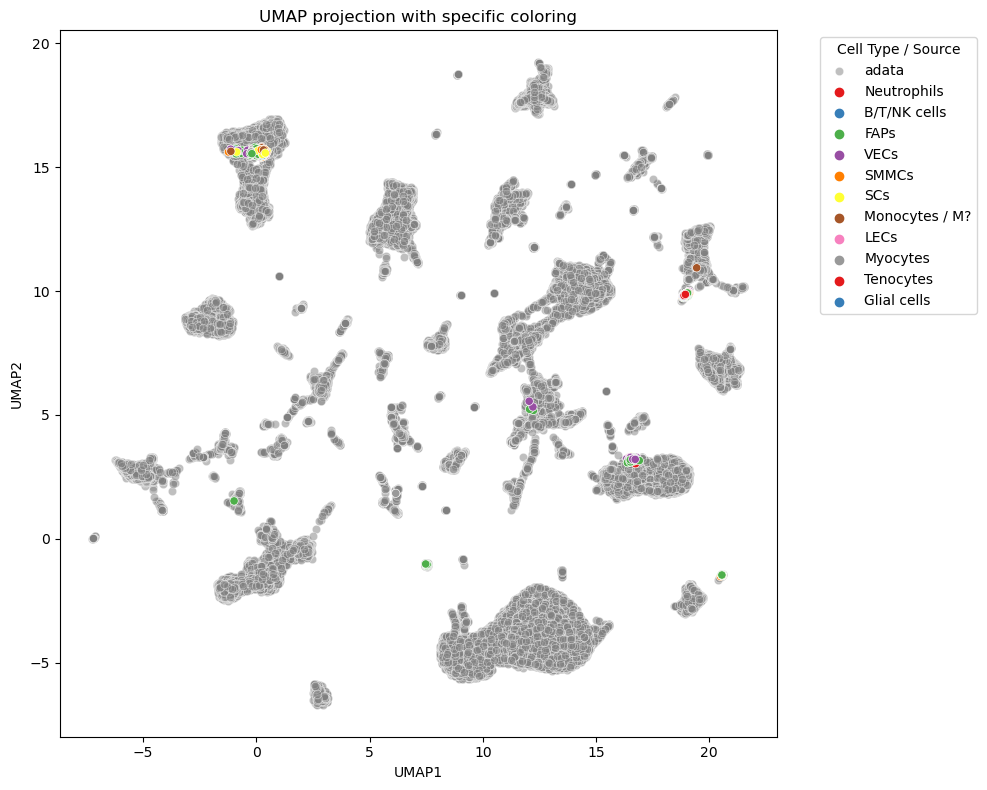

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

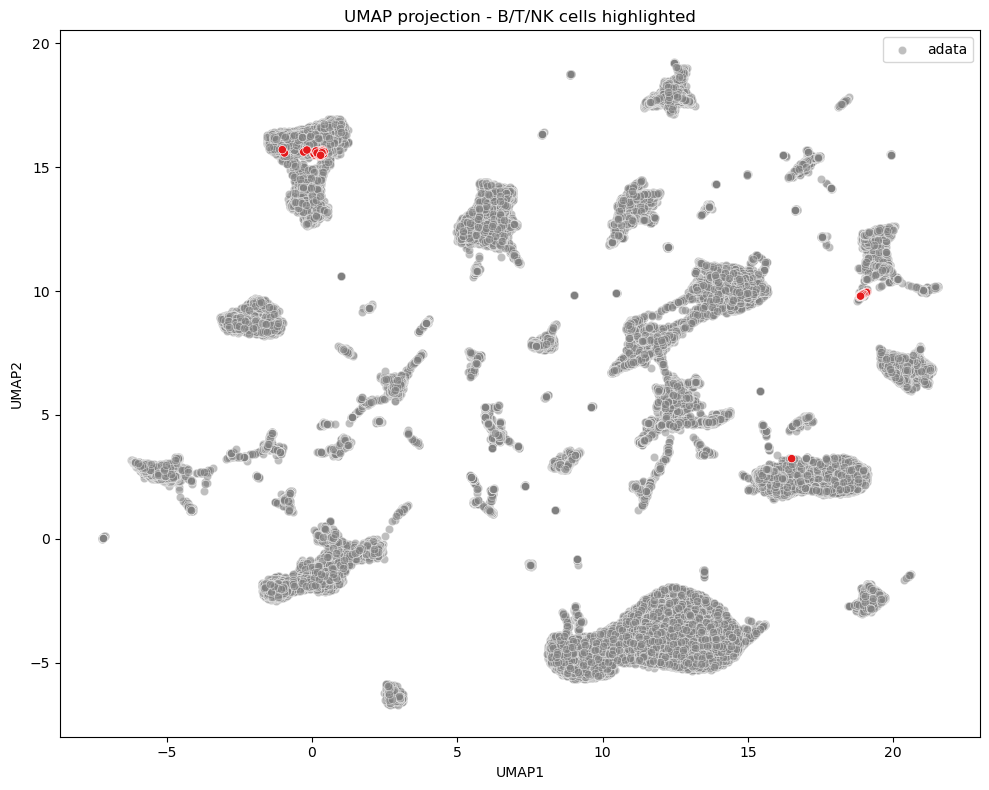

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

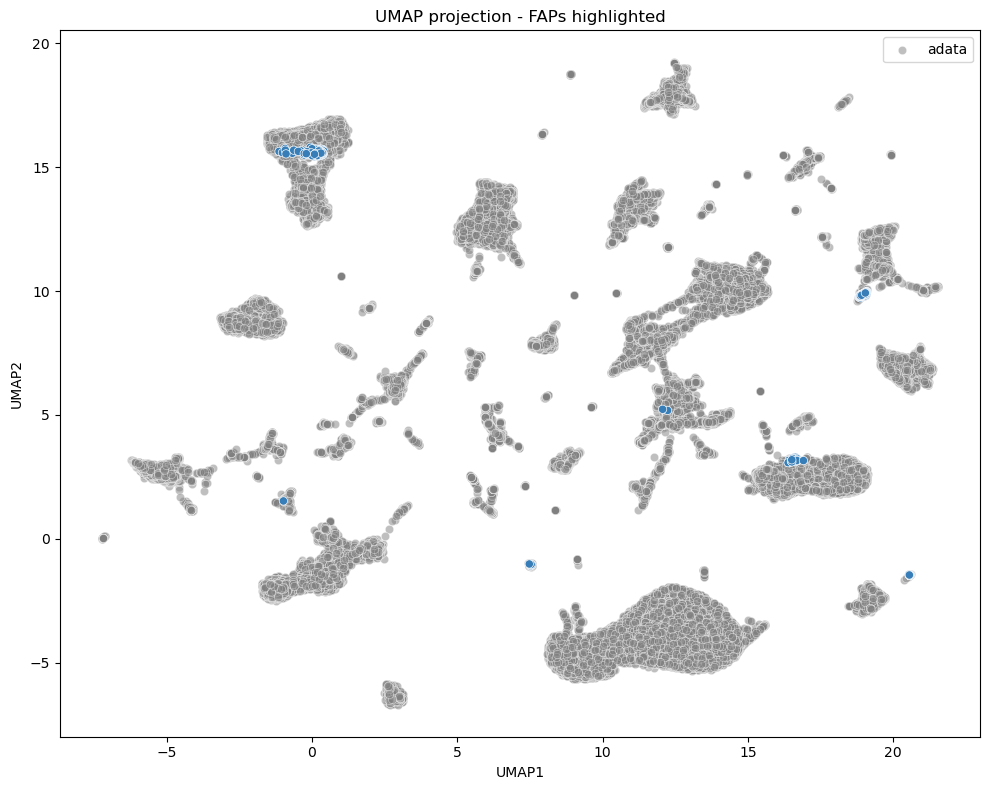

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

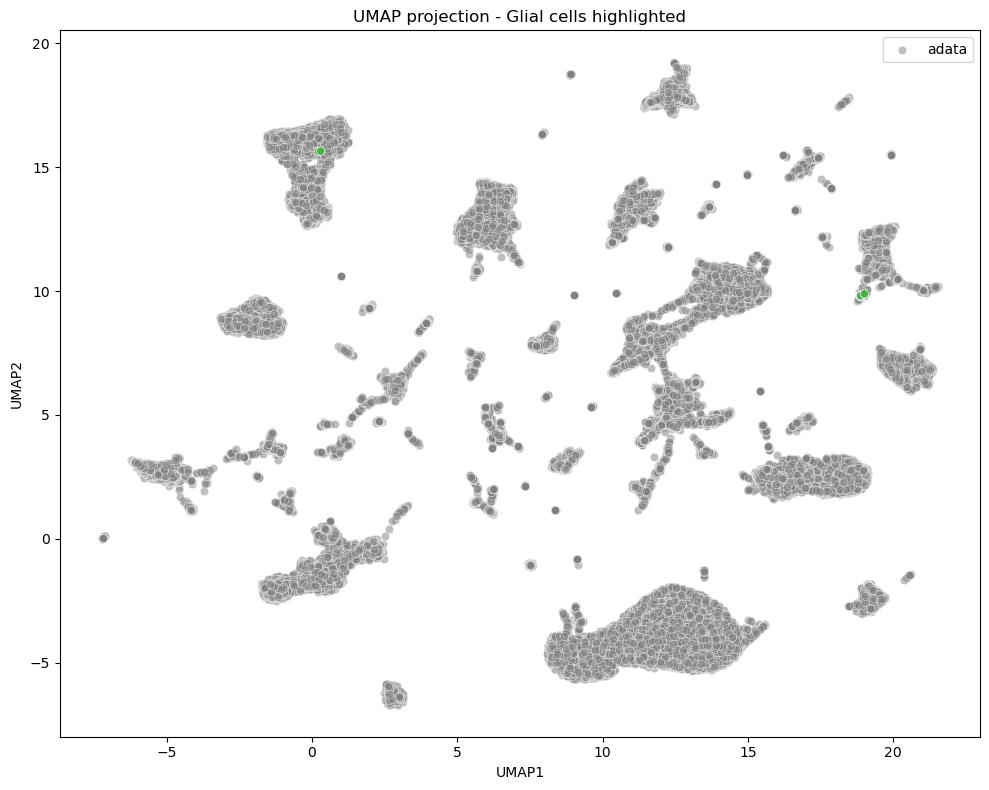

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

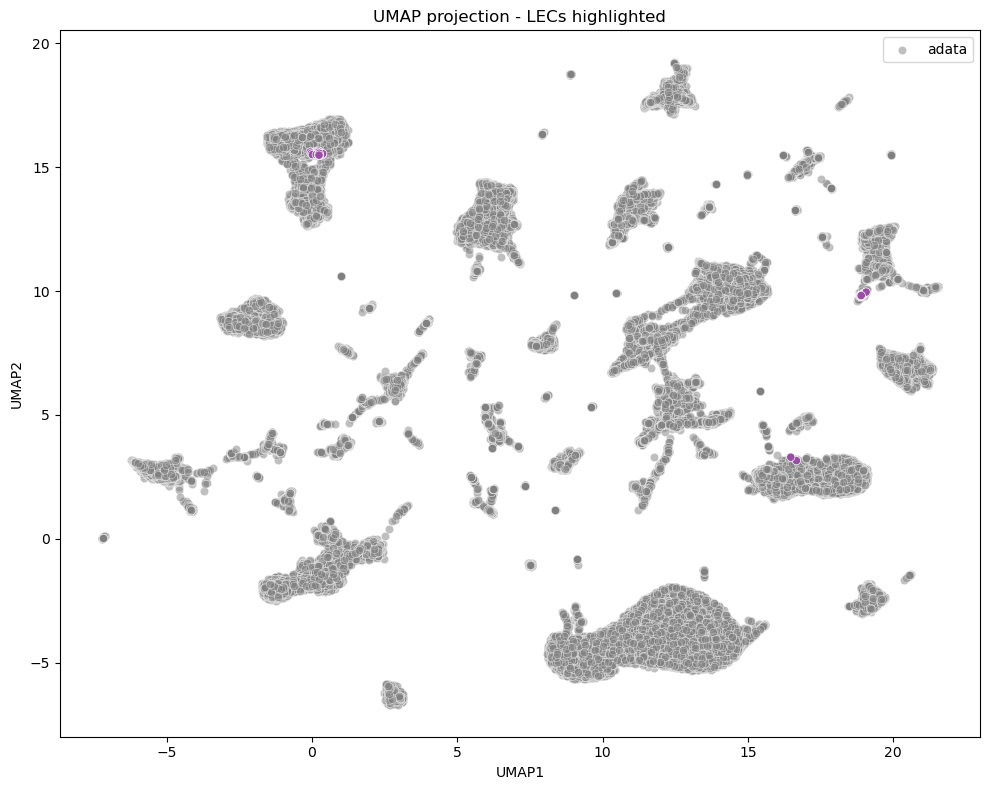

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

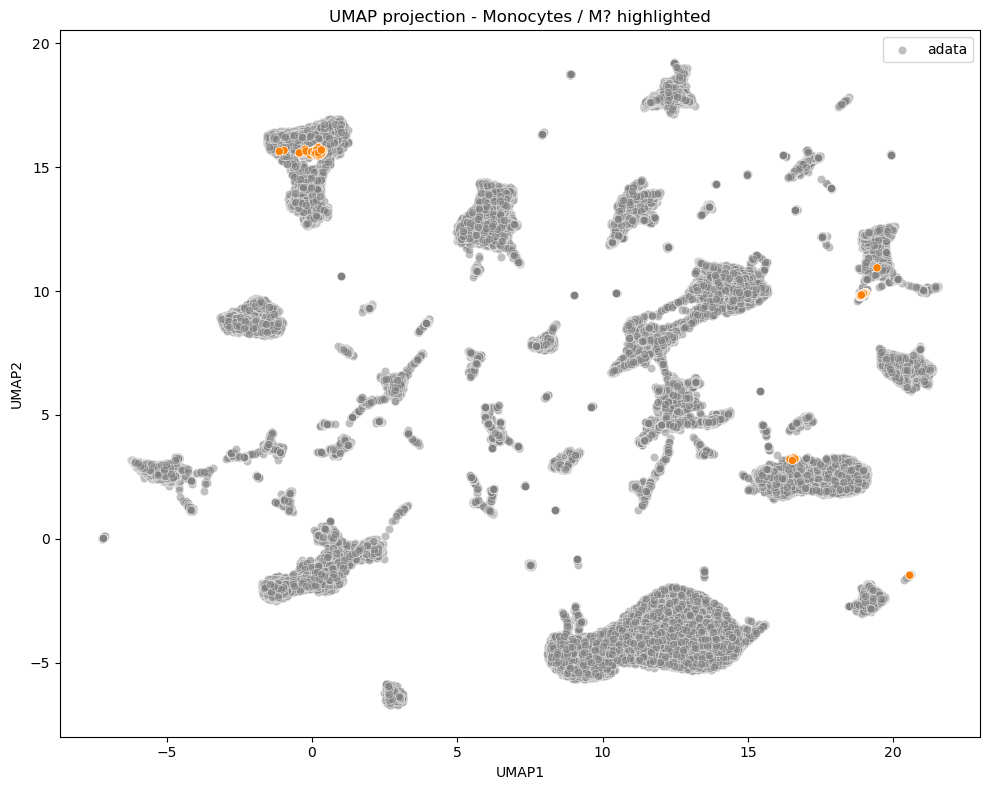

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

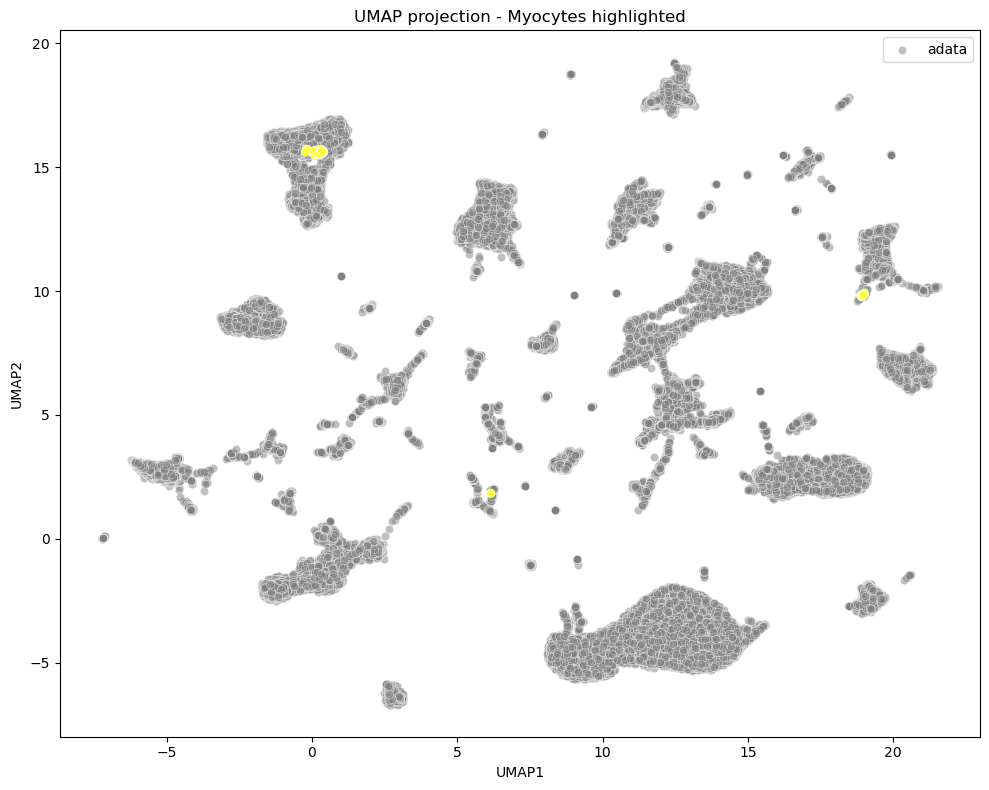

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

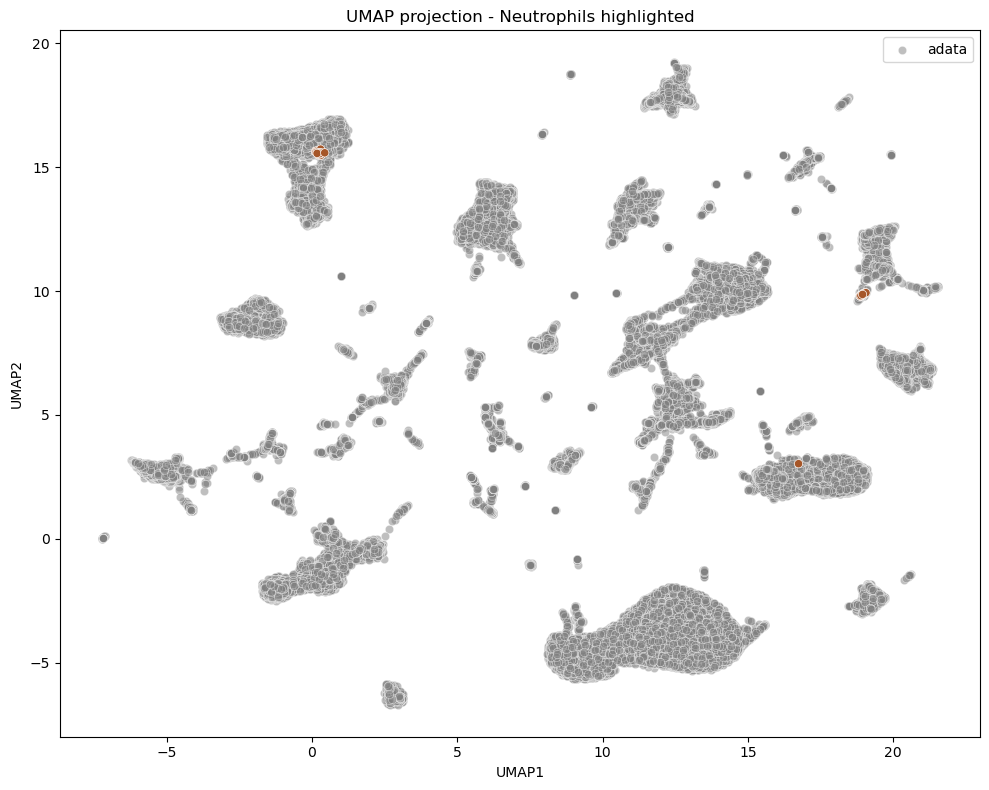

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

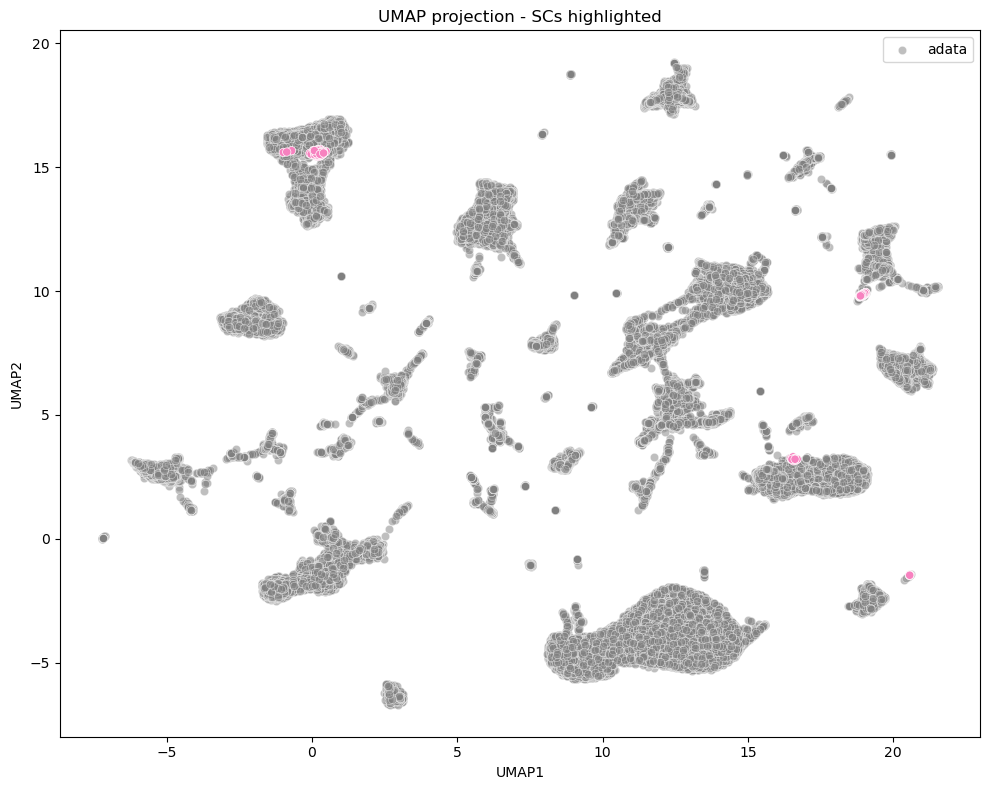

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

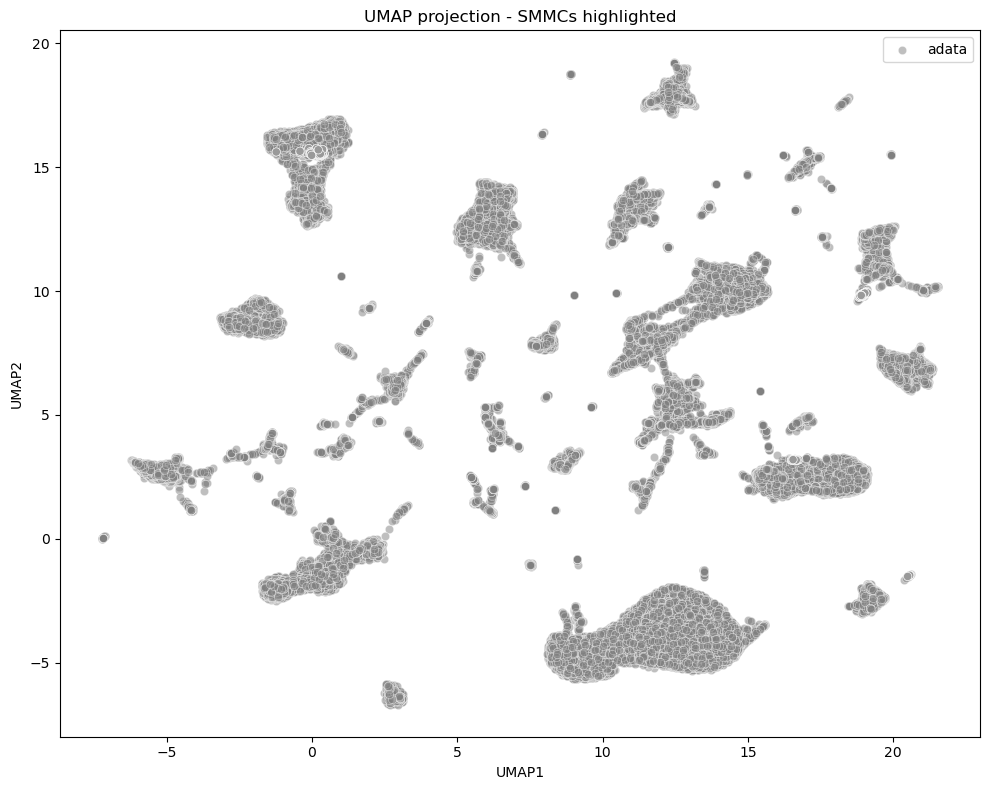

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

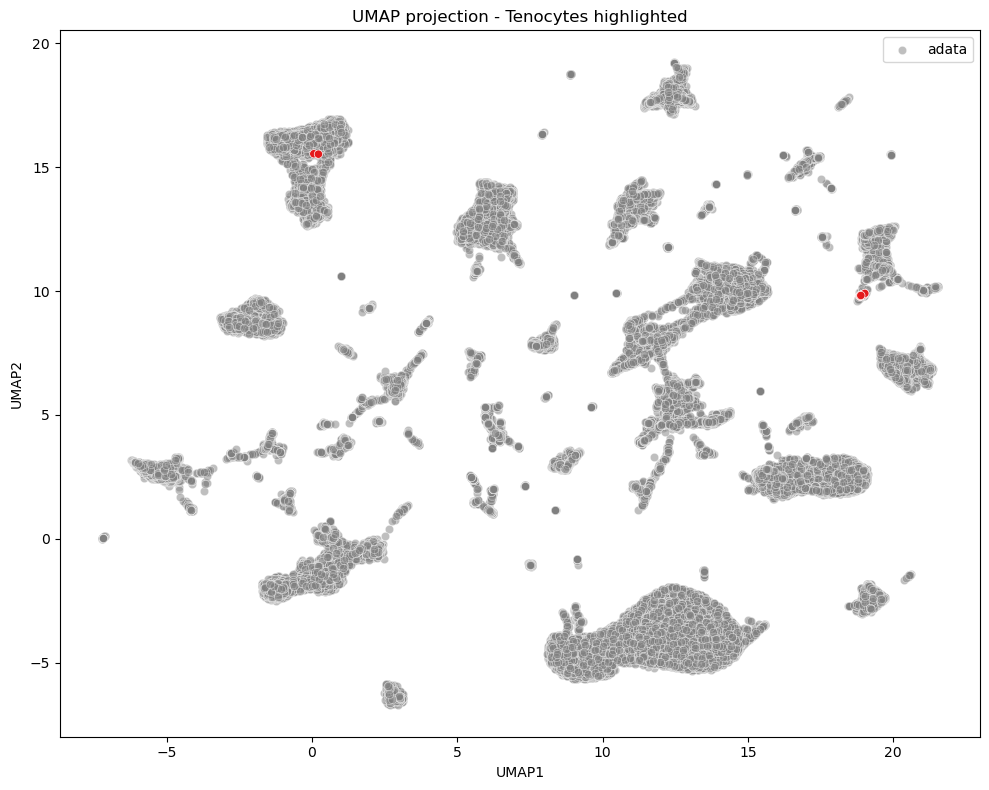

/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/storage/brno12-cerit/home/jiribruthans/miniconda3/envs/mess-env/lib/python3.11

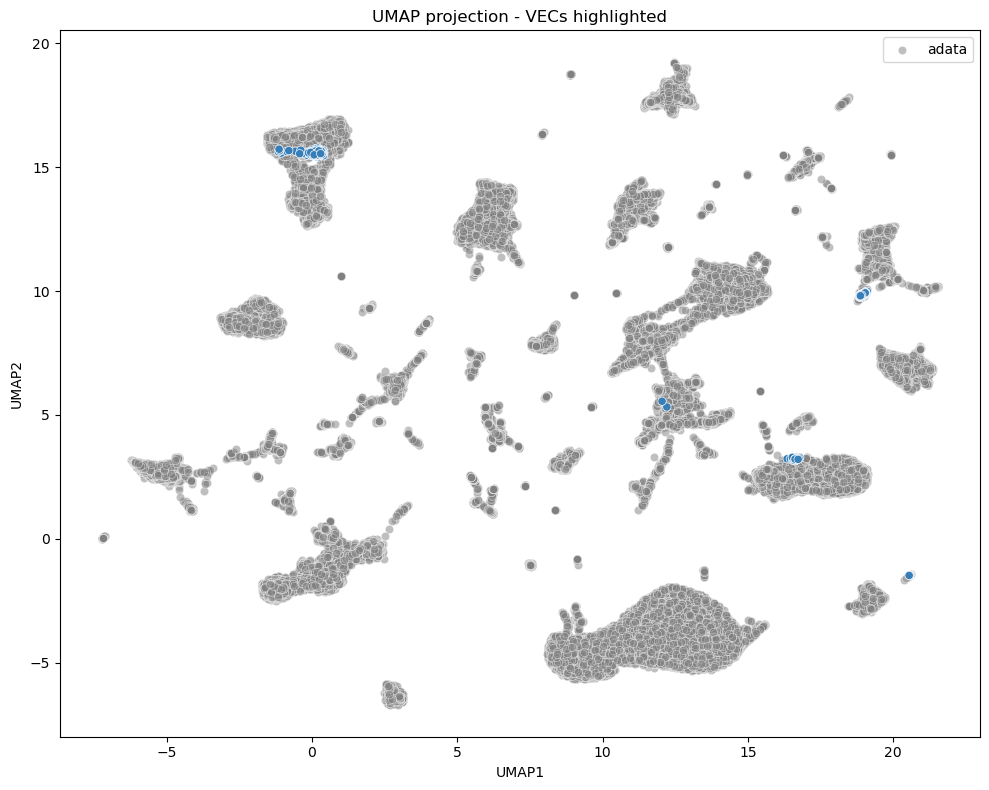

In [114]:
import matplotlib.pyplot as plt
import seaborn as sns
import umap
import pandas as pd
import numpy as np

# Assuming `adata` and `m_adata` are your AnnData objects

# Compute UMAP projections for adata using a single UMAP model
reducer = umap.UMAP()
umap_embeddings_adata = reducer.fit_transform(adata.obsm["emb"])

# Filter m_adata based on "orig.ident" == "Injection1"
filtered_m_adata = m_adata[m_adata.obs["orig.ident"] == "Injection1"]

# Compute UMAP for filtered m_adata using the same reducer
umap_embeddings_m_adata_filtered = reducer.transform(filtered_m_adata.obsm["X_uce"])

# Create a DataFrame for adata for easier plotting
df_adata = pd.DataFrame(umap_embeddings_adata, columns=['UMAP1', 'UMAP2'])
df_adata['Type'] = 'adata'  # All adata embeddings have the same type
df_adata['Source'] = 'adata'

# Create a DataFrame for filtered m_adata
df_m_adata_filtered = pd.DataFrame(umap_embeddings_m_adata_filtered, columns=['UMAP1', 'UMAP2'])
df_m_adata_filtered['Type'] = filtered_m_adata.obs["predicted.pheno"].values  # Using predicted phenotype for coloring
df_m_adata_filtered['Source'] = 'm_adata'

# Combine both DataFrames
df_combined = pd.concat([df_adata, df_m_adata_filtered], ignore_index=True)

# General Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(data=df_combined[df_combined['Source'] == 'adata'], x='UMAP1', y='UMAP2', color='grey', label='adata', alpha=0.5)
palette = sns.color_palette('Set1', n_colors=len(df_m_adata_filtered['Type'].unique()))
sns.scatterplot(data=df_combined[df_combined['Source'] == 'm_adata'], x='UMAP1', y='UMAP2', hue='Type', palette=palette)
plt.title('UMAP projection with specific coloring')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.legend(title='Cell Type / Source', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Phenotype-Specific Plotting
unique_phenotypes = np.unique(filtered_m_adata.obs["predicted.pheno"].values)

for phenotype in unique_phenotypes:
    plt.figure(figsize=(10, 8))
    sns.scatterplot(data=df_combined[df_combined['Source'] == 'adata'], x='UMAP1', y='UMAP2', color='grey', alpha=0.5, label='adata')
    phenotype_data = df_combined[(df_combined['Source'] == 'm_adata') & (df_combined['Type'] == phenotype)]
    sns.scatterplot(data=phenotype_data, x='UMAP1', y='UMAP2', hue='Type', palette=[palette[list(unique_phenotypes).index(phenotype)]], legend=False)
    plt.title(f'UMAP projection - {phenotype} highlighted')
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    plt.tight_layout()
    plt.show()
